In [1]:
import numpy as np
import tensorflow as tf
import os
import pandas as pd
import cv2
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from collections import Counter
import random

print("✅ NumPy:", np.__version__)
print("✅ TensorFlow:", tf.__version__)

✅ NumPy: 1.21.4
✅ TensorFlow: 2.6.0


In [2]:
# 작업 디렉토리 설정
base_dir = "/aiffel/aiffel/jellyfish"  # Cloud Shell에서 확인한 경로
if not os.path.exists(base_dir):
    print(f"오류: {base_dir} 경로가 존재하지 않습니다. 경로를 확인하세요.")
    raise FileNotFoundError(f"{base_dir} not found")

print("현재 디렉토리:", os.getcwd())
print("작업 디렉토리:", base_dir)

현재 디렉토리: /aiffel/aiffel
작업 디렉토리: /aiffel/aiffel/jellyfish


# 현재 디렉토리에서 클래스 폴더만 추출하기

In [3]:
# 클래스 폴더만 추출 (base_dir에서 읽기)
exclude_dirs = ['Train_Test_Valid', '__MACOSX', '.ipynb_checkpoints']
class_dirs = [d for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d)) and d not in exclude_dirs and not d.endswith('.zip')]

print(f"클래스 개수: {len(class_dirs)}")
print("클래스 목록:")
for cls in class_dirs:
    print(f" - {cls}")

클래스 개수: 6
클래스 목록:
 - compass_jellyfish
 - barrel_jellyfish
 - mauve_stinger_jellyfish
 - blue_jellyfish
 - lions_mane_jellyfish
 - Moon_jellyfish


In [4]:
# 클래스별 이미지 개수 계산
class_counts = {}
for cls in class_dirs:
    img_list = [f for f in os.listdir(os.path.join(base_dir, cls)) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    class_counts[cls] = len(img_list)
    print(f"{cls}: {len(img_list)} images")

compass_jellyfish: 150 images
barrel_jellyfish: 150 images
mauve_stinger_jellyfish: 150 images
blue_jellyfish: 150 images
lions_mane_jellyfish: 150 images
Moon_jellyfish: 150 images


# 클래스별 이미지 개수 시각화

- 모든 클래스의 이미지 개수가 거의 동일하게 분포
- 클래스 불균형 문제가 거의 없음 → 학습에 유리한 구조

데이터프레임 확인:
                      class  count
0        compass_jellyfish    150
1         barrel_jellyfish    150
2  mauve_stinger_jellyfish    150
3           blue_jellyfish    150
4     lions_mane_jellyfish    150
5           Moon_jellyfish    150


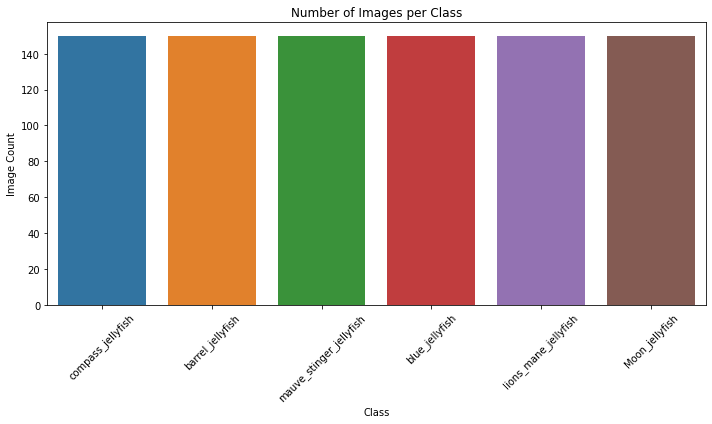

In [5]:
# DataFrame으로 변환 후 시각화
df_counts = pd.DataFrame(list(class_counts.items()), columns=['class', 'count'])
print("데이터프레임 확인:\n", df_counts)

plt.figure(figsize=(10, 6))
sns.barplot(data=df_counts, x='class', y='count')
plt.xticks(rotation=45)
plt.title("Number of Images per Class")
plt.xlabel("Class")
plt.ylabel("Image Count")
plt.tight_layout()
plt.show()

# 클래스별 샘플 이미지 몇 장씩 보기
- 배경이 다양하고, 일부는 수중 / 일부는 모래 위에 있음
- 각 해파리의 형태가 시각적으로 구별되는 경향이 있음

- 예: lions_mane_jellyfish는 촉수가 길고 풍성함
- blue_jellyfish는 푸른 색감이 뚜렷함
- Moon_jellyfish는 둥글고 반투명한 특징

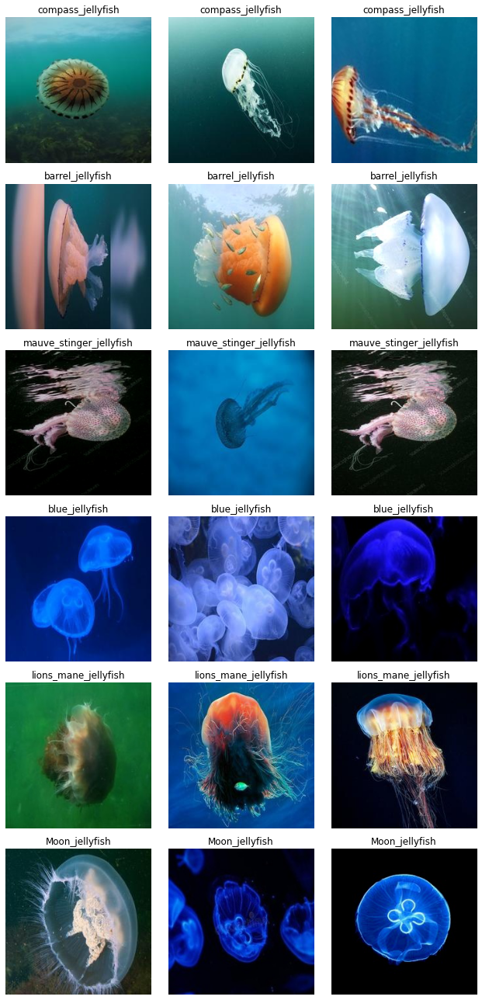

In [6]:
# 샘플 이미지 시각화
n_samples = 3
fig, axes = plt.subplots(len(class_dirs), n_samples, figsize=(n_samples*3, len(class_dirs)*3))
for row_idx, cls in enumerate(class_dirs):
    img_list = [f for f in os.listdir(os.path.join(base_dir, cls)) if f.lower().endswith(('.jpg', '.jpeg', '.png'))][:n_samples]
    for col_idx, img_name in enumerate(img_list):
        img_path = os.path.join(base_dir, cls, img_name)
        image = Image.open(img_path)
        axes[row_idx, col_idx].imshow(image)
        axes[row_idx, col_idx].set_title(f"{cls}")
        axes[row_idx, col_idx].axis("off")
    for col_idx in range(len(img_list), n_samples):
        axes[row_idx, col_idx].axis("off")

plt.tight_layout()
plt.show()

# 이미지 해상도 분포
- 224x224 해상도의 이미지가 가장 많음.
- 이 크기는 CNN 계열(특히 ResNet, VGG, MobileNet) 모델의 표준 입력 크기.

In [7]:
# 이미지 해상도 분석
sizes = []
for cls in class_dirs:
    for img_name in os.listdir(os.path.join(base_dir, cls)):  # base_dir 반영
        if img_name.lower().endswith(('.jpg', '.jpeg', '.png')):
            img_path = os.path.join(base_dir, cls, img_name)  # 절대 경로
            try:
                with Image.open(img_path) as img:
                    sizes.append(img.size)
            except:
                print(f"열 수 없는 이미지: {img_path}")

# 가장 흔한 해상도 Top 10
common_sizes = Counter(sizes).most_common(10)
print("가장 흔한 이미지 해상도 Top 10:")
for size, count in common_sizes:
    print(f"{size} - {count}장")

가장 흔한 이미지 해상도 Top 10:
(224, 224) - 632장
(179, 179) - 268장


In [8]:
# 데이터셋 로드
train_dir = os.path.join(base_dir, "Train_Test_Valid/Train")  # 절대 경로
val_dir = os.path.join(base_dir, "Train_Test_Valid/valid")    # 절대 경로
test_dir = os.path.join(base_dir, "Train_Test_Valid/test")    # 절대 경로

img_size = (224, 224)
batch_size = 32

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    image_size=img_size,
    batch_size=batch_size,
    shuffle=True,
    label_mode='categorical'
)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    val_dir,
    image_size=img_size,
    batch_size=batch_size,
    label_mode='categorical'
)

test_ds = tf.keras.preprocessing.image_dataset_from_directory(
    test_dir,
    image_size=img_size,
    batch_size=batch_size,
    shuffle=False,
    label_mode='categorical'
)

Found 900 files belonging to 6 classes.
Found 39 files belonging to 6 classes.
Found 40 files belonging to 6 classes.


배치 이미지 shape: (32, 224, 224, 3)


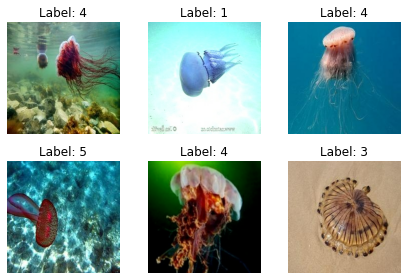

In [9]:
# train_ds에서 하나의 배치를 가져와 확인
for images, labels in train_ds.take(1):
    print(f"배치 이미지 shape: {images.shape}")  # → (batch_size, 224, 224, 3)
    for i in range(6):  # 앞의 6개 이미지만 시각화
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(f"Label: {np.argmax(labels[i].numpy())}")  # categorical이므로 argmax로 변환
        plt.axis("off")
    plt.tight_layout()
    plt.show()

# train/val/test 클래스 불균형 확인
- Valid, Test 매우 적음

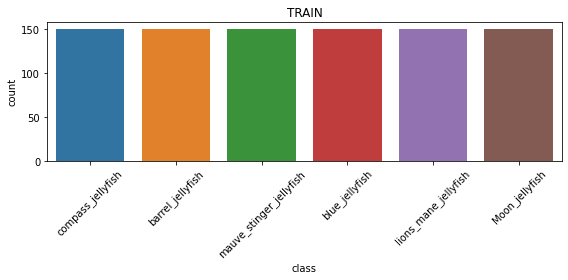

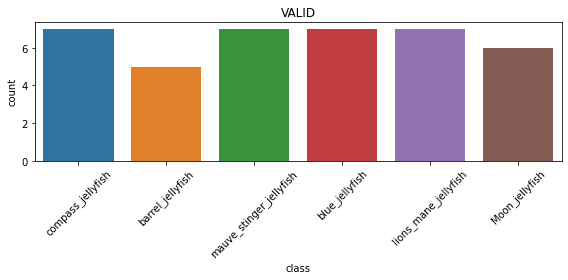

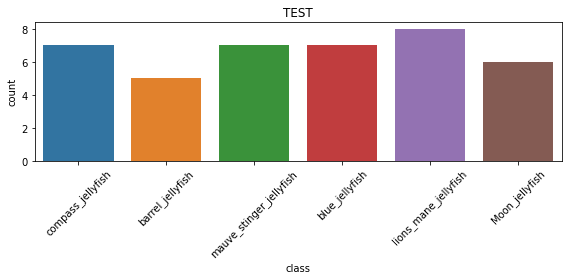

In [10]:
base = "/aiffel/aiffel/jellyfish/Train_Test_Valid"  # 절대 경로로 수정
splits = ['Train', 'valid', 'test']

for split in splits:
    split_dir = os.path.join(base, split)
    class_counts = {cls: len(os.listdir(os.path.join(split_dir, cls))) for cls in os.listdir(split_dir)}
    df = pd.DataFrame(list(class_counts.items()), columns=['class', 'count'])

    plt.figure(figsize=(8,4))
    sns.barplot(data=df, x='class', y='count')
    plt.title(f"{split.upper()}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# 이미지 품질 분석

## 샤프닝

선택된 이미지 경로: /aiffel/aiffel/jellyfish/compass_jellyfish/34.jpg


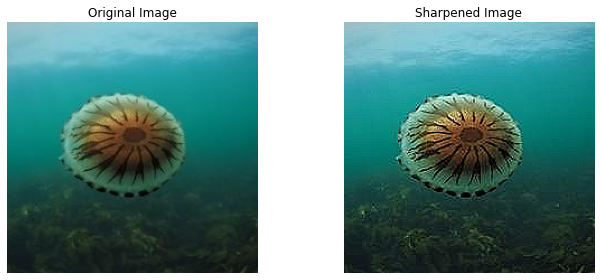

In [11]:
def sharpen_image(img_path, output_path=None):
    img = cv2.imread(img_path)
    if img is None:
        print(f"이미지를 불러오지 못했습니다: {img_path}")
        return

    # 샤프닝 커널 적용
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    sharpened = cv2.filter2D(img, -1, kernel)

    # 결과 저장 여부
    if output_path:
        cv2.imwrite(output_path, sharpened)
        print(f"샤프닝 이미지 저장 완료: {output_path}")

    # BGR → RGB 변환
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    sharpened_rgb = cv2.cvtColor(sharpened, cv2.COLOR_BGR2RGB)

    # 이미지 시각화
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(img_rgb)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(sharpened_rgb)
    plt.title("Sharpened Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

# base_dir 정의 (맥락 유지)
base_dir = "/aiffel/aiffel/jellyfish"
cls = os.path.join(base_dir, class_dirs[0])  # 절대 경로로 수정
img_list = [f for f in os.listdir(cls) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

if img_list:
    img_path = os.path.join(cls, img_list[0])
    print(f"선택된 이미지 경로: {img_path}")
    sharpen_image(img_path)
else:
    print(f"{cls} 폴더에 이미지가 없습니다.")

## 선명도(Blur 여부) 판단
### 값이 클수록 선명한 이미지, 작을수록 흐린 이미지

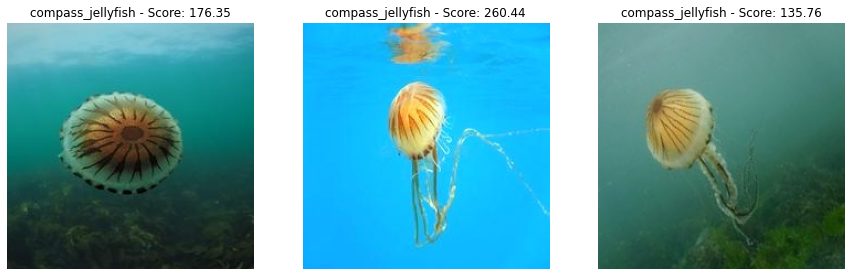

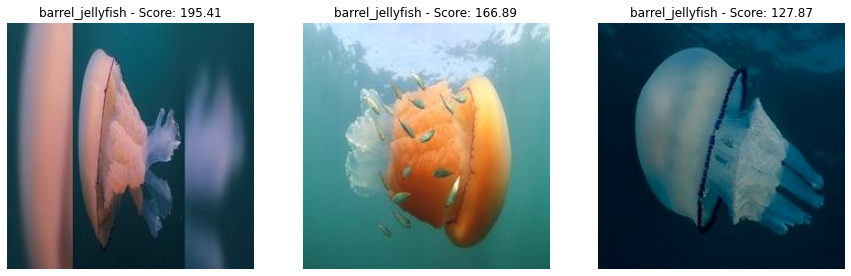

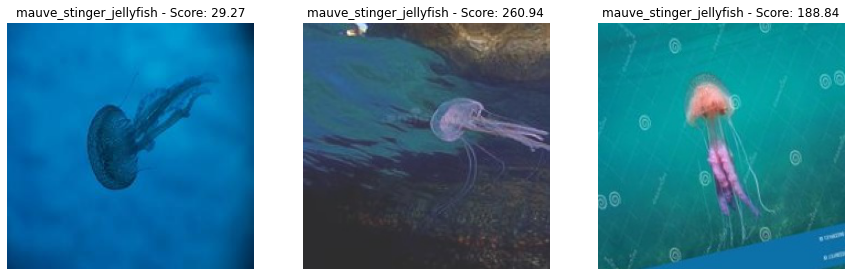

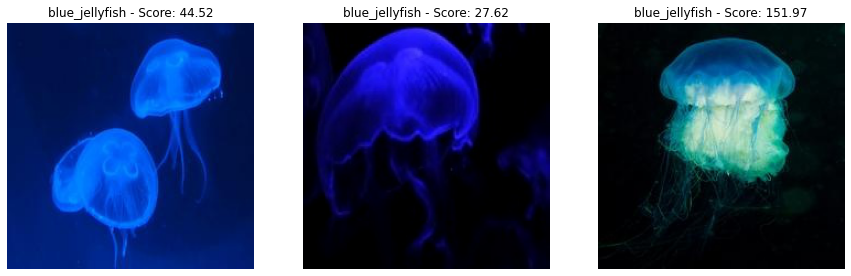

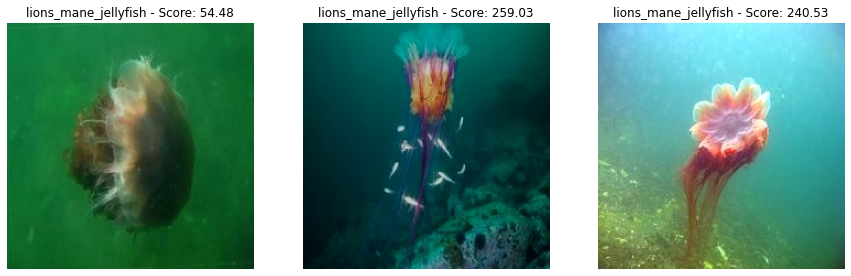

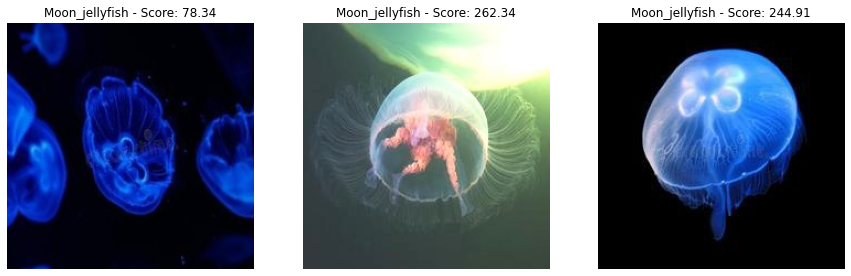

In [12]:
def check_blurriness(img_path):
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    return cv2.Laplacian(img, cv2.CV_64F).var()

def show_blurry_images(species_dir, threshold=300):
    blurry_images = []
    for img_name in os.listdir(species_dir):
        img_path = os.path.join(species_dir, img_name)
        score = check_blurriness(img_path)
        if score < threshold:
            blurry_images.append((img_path, score))
    
    if blurry_images:
        plt.figure(figsize=(15, 5))
        for i, (img_path, score) in enumerate(blurry_images[:3]):
            img = Image.open(img_path)
            plt.subplot(1, 3, i+1)
            plt.imshow(img)
            plt.title(f"{os.path.basename(species_dir)} - Score: {score:.2f}")
            plt.axis('off')
        plt.show()

# base_dir 정의 (맥락 유지)
base_dir = "/aiffel/aiffel/jellyfish"
for species_dir in [os.path.join(base_dir, cls) for cls in class_dirs]:  # 절대 경로로 수정
    show_blurry_images(species_dir)

## 전경(해파리)과 배경의 선명도를 따로 측정하고 비교

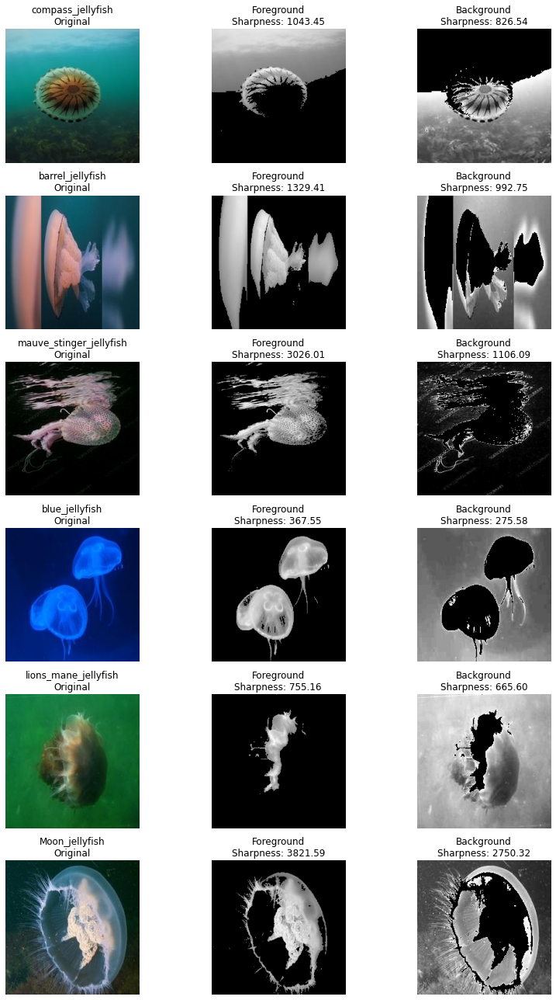

In [13]:
def analyze_foreground_background(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # 전경 / 배경 마스크 생성
    fg_mask = cv2.bitwise_and(gray, thresh)
    bg_mask = cv2.bitwise_and(gray, cv2.bitwise_not(thresh))

    # 전경 / 배경 선명도 계산
    foreground_var = cv2.Laplacian(fg_mask, cv2.CV_64F).var()
    background_var = cv2.Laplacian(bg_mask, cv2.CV_64F).var()

    return fg_mask, bg_mask, foreground_var, background_var, img

# base_dir 정의 (맥락 유지)
base_dir = "/aiffel/aiffel/jellyfish"
plt.figure(figsize=(12, 3 * len(class_dirs)))

for i, species_dir in enumerate([os.path.join(base_dir, cls) for cls in class_dirs]):  # 절대 경로로 수정
    img_files = [f for f in os.listdir(species_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    if not img_files:
        continue

    img_path = os.path.join(species_dir, img_files[0])
    fg_mask, bg_mask, fg_var, bg_var, original = analyze_foreground_background(img_path)

    # 원본 이미지
    plt.subplot(len(class_dirs), 3, i * 3 + 1)
    plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    plt.title(f"{os.path.basename(species_dir)}\nOriginal")
    plt.axis('off')

    # 전경 이미지
    plt.subplot(len(class_dirs), 3, i * 3 + 2)
    plt.imshow(fg_mask, cmap='gray')
    plt.title(f"Foreground\nSharpness: {fg_var:.2f}")
    plt.axis('off')

    # 배경 이미지
    plt.subplot(len(class_dirs), 3, i * 3 + 3)
    plt.imshow(bg_mask, cmap='gray')
    plt.title(f"Background\nSharpness: {bg_var:.2f}")
    plt.axis('off')

plt.tight_layout()
plt.show()

# 증강

## 각 종별 특성 강화

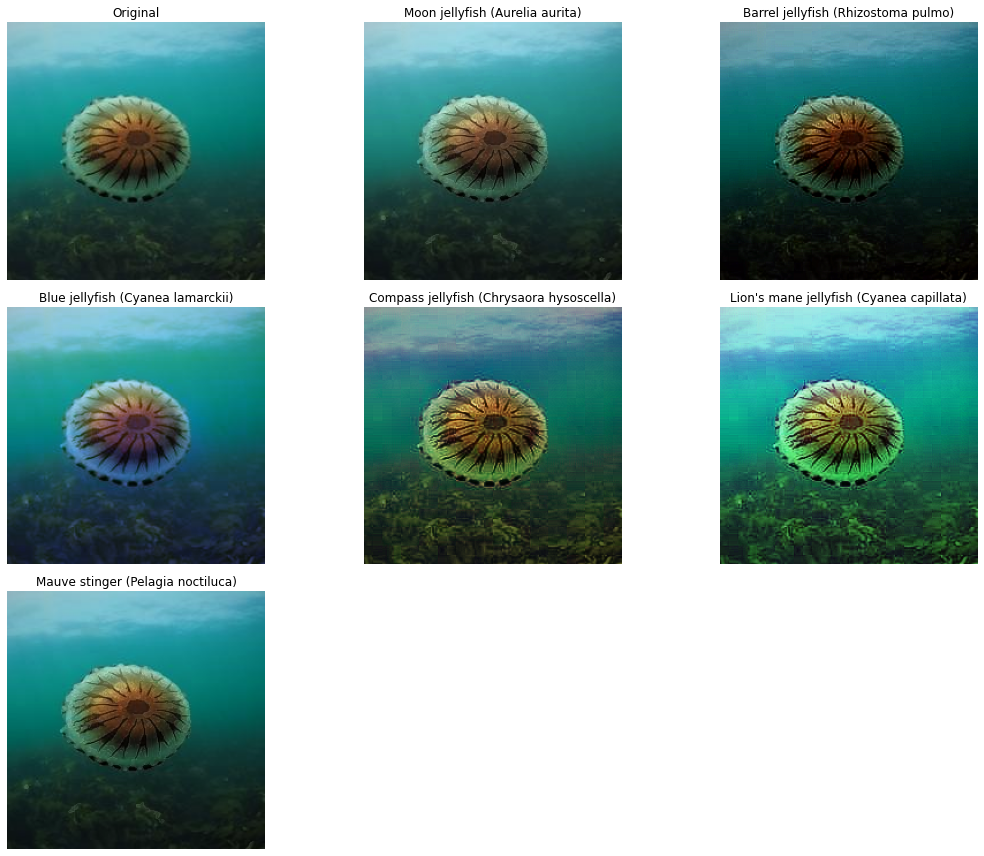

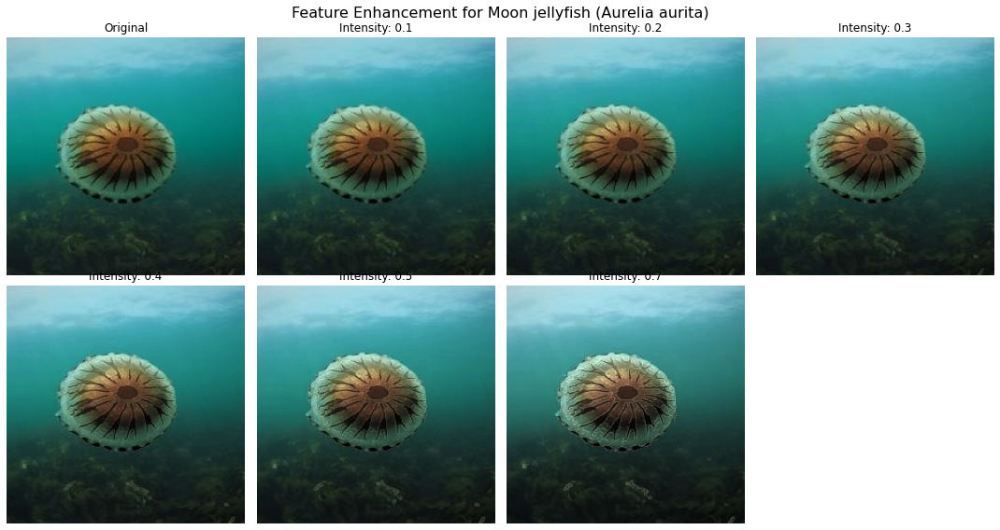

In [14]:
class JellyfishFeaturesAugmentation:
    """
    해파리 종별 특성을 강화하는 데이터 증강 전략
    각 종별 고유한 형태적 특징을 강조하여 분류 성능 향상
    """
    
    def __init__(self, p=0.8):
        """
        매개변수:
            p: 증강이 적용될 확률
        """
        self.p = p
        self.species_dict = {
            "moon": "Moon jellyfish (Aurelia aurita)",
            "barrel": "Barrel jellyfish (Rhizostoma pulmo)",
            "blue": "Blue jellyfish (Cyanea lamarckii)",
            "compass": "Compass jellyfish (Chrysaora hysoscella)",
            "lions_mane": "Lion's mane jellyfish (Cyanea capillata)",
            "mauve_stinger": "Mauve stinger (Pelagia noctiluca)"
        }
        
    def enhance_moon_jellyfish(self, image, intensity=0.3):
        """
        Moon jellyfish (Aurelia aurita) 특성 강화
        - 반투명한 몸통과 4개의 말발굽 모양 생식선 강조
        - 특징: 투명도, 원형 패턴, 생식선 가시성
        - 강화할 특징: 높은 RGB 밝기, 투명도, 엣지.
        """
        result = image.copy().astype(np.uint8)

        # 1. 밝기 증가
        gamma = 1.0 - intensity * 0.3
        inv_gamma = 1.0 / gamma
        table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
        result = cv2.LUT(result, table)

        # 2. 투명도 효과 (채도 감소)
        hsv = cv2.cvtColor(result, cv2.COLOR_RGB2HSV)
        hsv[:, :, 1] = hsv[:, :, 1] * (1 - intensity * 0.5)
        hsv[:, :, 2] = np.clip(hsv[:, :, 2] * (1 + intensity * 0.2), 0, 255)
        result = cv2.cvtColor(hsv.astype(np.uint8), cv2.COLOR_HSV2RGB)

        # 3. 엣지 강조
        edges = cv2.Canny(cv2.cvtColor(result, cv2.COLOR_RGB2GRAY), 50, 150)
        edges_rgb = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
        result = cv2.addWeighted(result, 1.0, edges_rgb, intensity * 0.2, 0)

        return result
    
    def enhance_barrel_jellyfish(self, image, intensity=0.3):
        """
        Barrel jellyfish (Rhizostoma pulmo) 특성 강화
        - 크고 둥근 형태, 두꺼운 몸체 강조
        - 특징: 크기, 부피감, 견고한 형태
        - 강화할 특징: 높은 RGB 밝기, 선명도.
        """
        result = image.copy().astype(np.uint8)

        # 1. 밝기 증가 (Gamma 보정)
        gamma = 1.0 - intensity * 0.4
        inv_gamma = 1.0 / gamma
        table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
        result = cv2.LUT(result, table)

        # 2. 대비 증가
        result = tf.image.adjust_contrast(result, 1 + intensity * 0.5).numpy().astype(np.uint8)

        # 3. 샤프닝
        sharpen_kernel = np.array([[-1, -1, -1],
                                    [-1, 9, -1],
                                    [-1, -1, -1]])
        sharpened = cv2.filter2D(result, -1, sharpen_kernel * intensity)
        result = cv2.addWeighted(result, 1 - intensity, sharpened, intensity, 0)
        
        return result
    
    def enhance_blue_jellyfish(self, image, intensity=0.3):
        """
        Blue jellyfish (Cyanea lamarckii) 특성 강화
        - 푸른색 색조가 강한 해파리
        - 특징: 푸른색, 중간 크기 형태
        - 강화할 특징: B 색상, 낮은 엣지.
        """
        result = image.copy().astype(np.uint8)

        # 1. B 채널 CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        result[:, :, 2] = clahe.apply(result[:, :, 2])  # B 채널

        # 2. Gaussian Blur (엣지 부드럽게)
        blurred = cv2.GaussianBlur(result, (5, 5), sigmaX=1.5 * intensity)
        result = cv2.addWeighted(result, 1 - intensity, blurred, intensity, 0)

        return result
    
    def enhance_compass_jellyfish(self, image, intensity=0.3):
        """
        Compass jellyfish (Chrysaora hysoscella) 특성 강화
        - 몸통의 갈색 나침반 모양 패턴이 특징
        - 특징: 독특한 나침반 무늬, 갈색 패턴
        - 강화할 특징: G/R 색상, 선명도.
        """
        result = image.copy().astype(np.uint8)

        # 1. G/R 채널 CLAHE 적용
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        for c in [0, 1]:  # R, G 채널
            result[:, :, c] = clahe.apply(result[:, :, c])

        # 2. 샤프닝 필터
        sharpen_kernel = np.array([[-1, -1, -1],
                                    [-1, 9, -1],
                                    [-1, -1, -1]])
        sharpened = cv2.filter2D(result, -1, sharpen_kernel * intensity)

        # 3. 블렌딩
        result = cv2.addWeighted(result, 1 - intensity, sharpened, intensity, 0)
        
        return result
    
    def enhance_lions_mane_jellyfish(self, image, intensity=0.3):
        """
        Lion's mane jellyfish (Cyanea capillata) 특성 강화
        - 세계에서 가장 큰 해파리, 긴 촉수가 특징
        - 특징: 크기, 붉은 색조, 많은 촉수
        - 강화할 특징: G 색상, 높은 선명도.
        """
        result = image.copy().astype(np.uint8)

        # 1. G 채널 CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        result[:, :, 1] = clahe.apply(result[:, :, 1])  # G 채널

        # 2. 강한 샤프닝
        sharpen_kernel = np.array([[-1, -1, -1],
                                    [-1, 10, -1],
                                    [-1, -1, -1]])
        sharpened = cv2.filter2D(result, -1, sharpen_kernel * (intensity + 0.2))
        result = cv2.addWeighted(result, 1 - intensity, sharpened, intensity, 0)

        return result
    
    def enhance_mauve_stinger(self, image, intensity=0.3):
        """
        Mauve stinger (Pelagia noctiluca) 특성 강화
        - 작은 해파리, 긴 촉수와 독을 쏘는 세포가 있는 혹 구조
        - 특징: 자주색 색조, 작은 크기, 표면의 혹 모양 구조
        - 강화할 특징: 엣지, 중간 밝기 RGB.
        """
        result = image.copy().astype(np.uint8)

        # 1. 밝기 증가
        gamma = 1.0 - intensity * 0.3
        inv_gamma = 1.0 / gamma
        table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
        result = cv2.LUT(result, table)

        # 2. 엣지 강조 (Canny)
        gray = cv2.cvtColor(result, cv2.COLOR_RGB2GRAY)
        edges = cv2.Canny(gray, 50, 150)
        edges_rgb = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
        result = cv2.addWeighted(result, 1.0, edges_rgb, intensity * 0.2, 0)
        
        return result
    
    def apply(self, image, species=None, intensity=0.3):
        """
        이미지에 해파리 종별 특성 강화 효과 적용
        
        매개변수:
            image: 입력 이미지
            species: 해파리 종류 ('moon', 'barrel', 'blue', 'compass', 'lions_mane', 'mauve_stinger')
                    None이면 무작위 선택
            intensity: 효과 강도 (0.0 ~ 1.0)
        """
        if random.random() > self.p:
            return image
            
        result = image.copy()
        
        # 종이 지정되지 않은 경우 무작위 선택
        if species is None:
            species = random.choice(list(self.species_dict.keys()))
            
        # 종에 따른 강화 함수 적용
        if species == 'moon':
            result = self.enhance_moon_jellyfish(result, intensity)
        elif species == 'barrel':
            result = self.enhance_barrel_jellyfish(result, intensity)
        elif species == 'blue':
            result = self.enhance_blue_jellyfish(result, intensity)
        elif species == 'compass':
            result = self.enhance_compass_jellyfish(result, intensity)
        elif species == 'lions_mane':
            result = self.enhance_lions_mane_jellyfish(result, intensity)
        elif species == 'mauve_stinger':
            result = self.enhance_mauve_stinger(result, intensity)
            
        return result
    
    def visualize_enhancements(self, image, figsize=(15, 12)):
        """
        각 해파리 종별 특성 강화 효과 시각화
        """
        species_list = list(self.species_dict.keys())
        
        plt.figure(figsize=figsize)
        
        # 원본 이미지 표시
        plt.subplot(3, 3, 1)
        plt.imshow(image)
        plt.title("Original")
        plt.axis('off')
        
        # 각 종별 특성 강화 적용 및 시각화
        for i, species in enumerate(species_list):
            plt.subplot(3, 3, i + 2)
            enhanced = self.apply(image.copy(), species, intensity=0.4)
            plt.imshow(enhanced)
            plt.title(self.species_dict[species])
            plt.axis('off')
            
        plt.tight_layout()
        plt.show()
    
    def visualize_intensity_levels(self, image, species):
        """
        특정 종에 대한 다양한 강도 수준의 증강 효과 시각화
        """
        intensities = [0.1, 0.2, 0.3, 0.4, 0.5, 0.7]
        
        plt.figure(figsize=(15, 8))
        
        # 원본 이미지 표시
        plt.subplot(2, 4, 1)
        plt.imshow(image)
        plt.title("Original")
        plt.axis('off')
        
        # 다양한 강도 수준 적용 및 시각화
        for i, intensity in enumerate(intensities):
            plt.subplot(2, 4, i + 2)
            enhanced = self.apply(image.copy(), species, intensity=intensity)
            plt.imshow(enhanced)
            plt.title(f"Intensity: {intensity}")
            plt.axis('off')
            
        plt.suptitle(f"Feature Enhancement for {self.species_dict[species]}", fontsize=16)
        plt.tight_layout()
        plt.show()

# 호출 예제 (경로 에러 방지)
base_dir = "/aiffel/aiffel/jellyfish"
cls = os.path.join(base_dir, class_dirs[0])  # 첫 번째 클래스 폴더 (예: compass_jellyfish)
img_list = [f for f in os.listdir(cls) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

if img_list:
    img_path = os.path.join(cls, img_list[0])
    image = cv2.imread(img_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # RGB로 변환
    augmenter = JellyfishFeaturesAugmentation(p=1.0)
    augmenter.visualize_enhancements(image_rgb)  # 모든 종별 증강 시각화
    augmenter.visualize_intensity_levels(image_rgb, species="moon")  # Moon jellyfish 강도별 시각화
else:
    print(f"{cls} 폴더에 이미지가 없습니다.")

In [15]:
# 사용 예시
def demo_feature_enhancement(image_path):
    """
    해파리 종별 특성 강화 데모 함수
    """
    # 이미지 로드
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # 증강기 초기화
    augmenter = JellyfishFeaturesAugmentation(p=1.0)
    
    # 모든 종에 대한 특성 강화 시각화
    augmenter.visualize_enhancements(image)
    
    # 특정 종에 대한 다양한 강도 시각화
    augmenter.visualize_intensity_levels(image, 'compass')

    
# 배치 데이터에 증강 적용 예시
def apply_batch_enhancement(images, labels, species_mapping):
    """
    배치 데이터에 종별 맞춤형 증강 적용
    
    매개변수:
        images: 이미지 배치
        labels: 레이블 배치
        species_mapping: 레이블 인덱스와 종 이름 매핑 딕셔너리
    """
    augmenter = JellyfishFeaturesAugmentation(p=0.7)
    enhanced_images = []
    
    for img, label in zip(images, labels):
        # 레이블 인덱스에 해당하는 종 이름 확인
        species_key = species_mapping[label]
        
        # 종별 맞춤형 증강 적용
        enhanced = augmenter.apply(img, species=species_key)
        enhanced_images.append(enhanced)
    
    return np.array(enhanced_images)


# Albumentations와 함께 사용하는 예시
def get_feature_enhancement_transform(species=None):
    """
    ㅠ 변환과 결합된 특성 강화 증강 생성
    
    매개변수:
        species: 특정 종 지정 (None이면 무작위)
    """
    augmenter = JellyfishFeaturesAugmentation(p=0.7)
    
    transform = A.Compose([
        # 기본 기하학적 변환
        A.RandomRotate90(),
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=45, p=0.7),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        
        # 커스텀 증강 적용 (Lambda 사용)
        A.Lambda(image=lambda img, **kwargs: augmenter.apply(img, species=species)),
        
        # 최종 정규화
        A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    
    return transform


# TensorFlow 데이터 파이프라인에서 사용하는 예시
def jellyfish_feature_enhancement_tf(image, label, species_mapping):
    """
    TensorFlow 데이터 파이프라인에서 사용 가능한 증강 래퍼
    
    매개변수:
        image: 입력 이미지 텐서
        label: 레이블 텐서
        species_mapping: 레이블 인덱스와 종 이름 매핑 딕셔너리
    """
    augmenter = JellyfishFeaturesAugmentation(p=0.7)
    
    # 레이블에 따른 종 확인
    species_key = species_mapping[label.numpy()]
    
    # numpy 배열로 변환하여 증강 적용
    image_np = image.numpy()
    enhanced_np = augmenter.apply(image_np, species=species_key)
    
    # 텐서로 다시 변환
    enhanced = tf.convert_to_tensor(enhanced_np, dtype=tf.float32)
    
    return enhanced, label

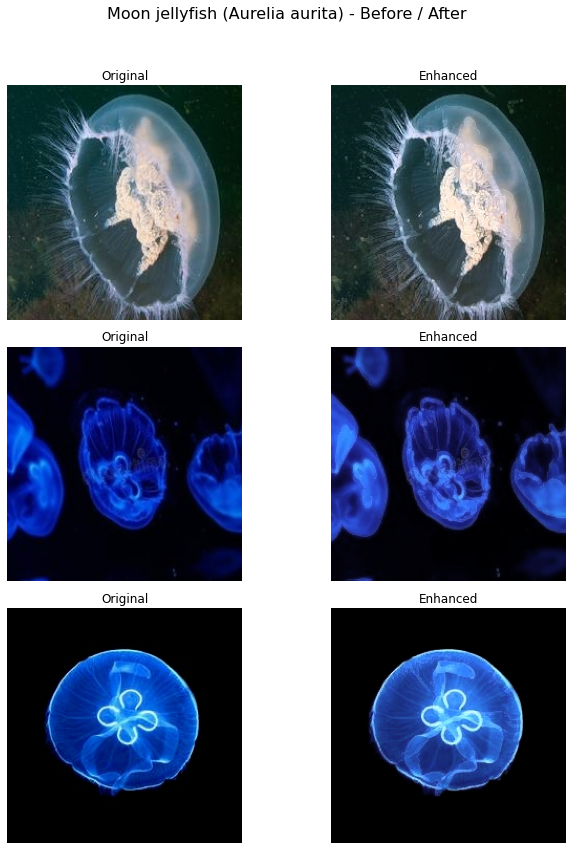

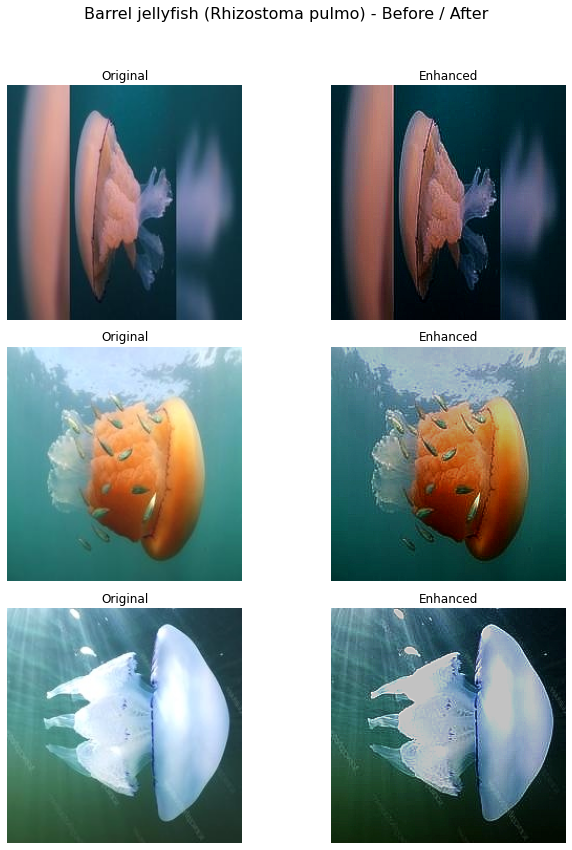

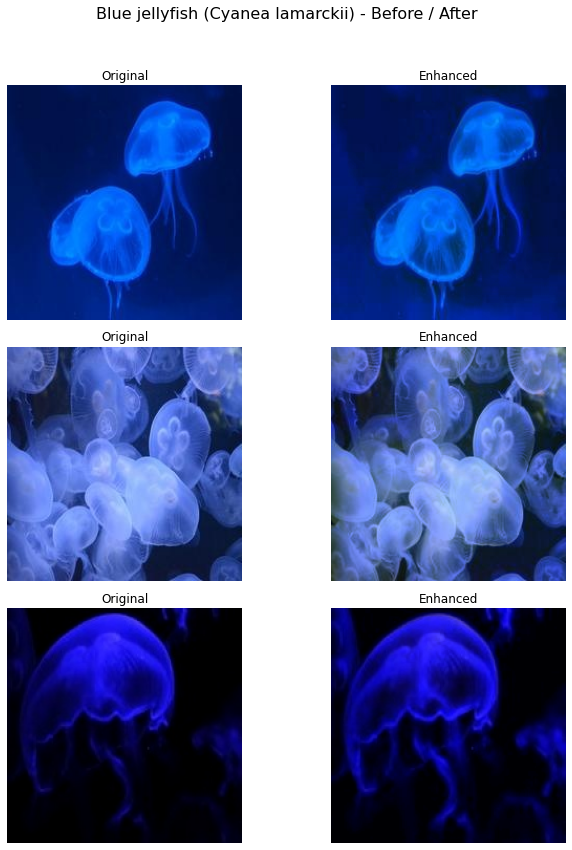

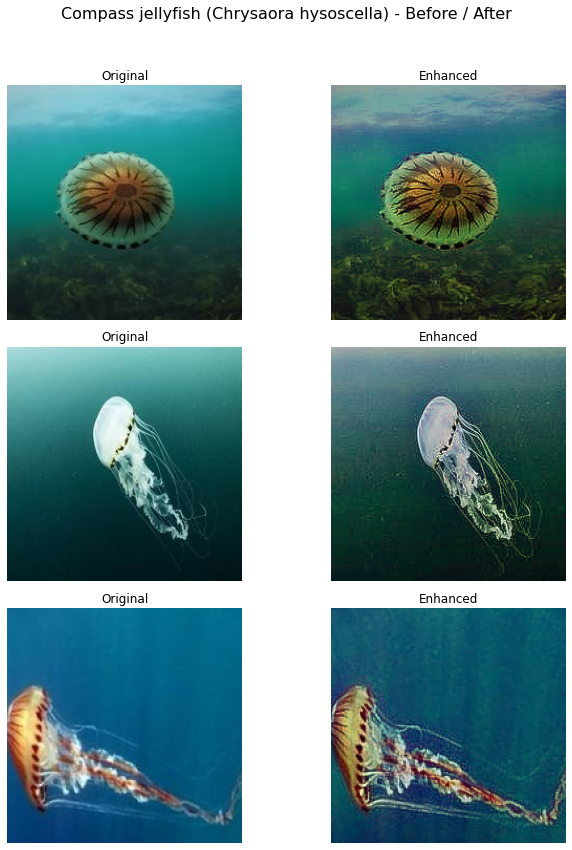

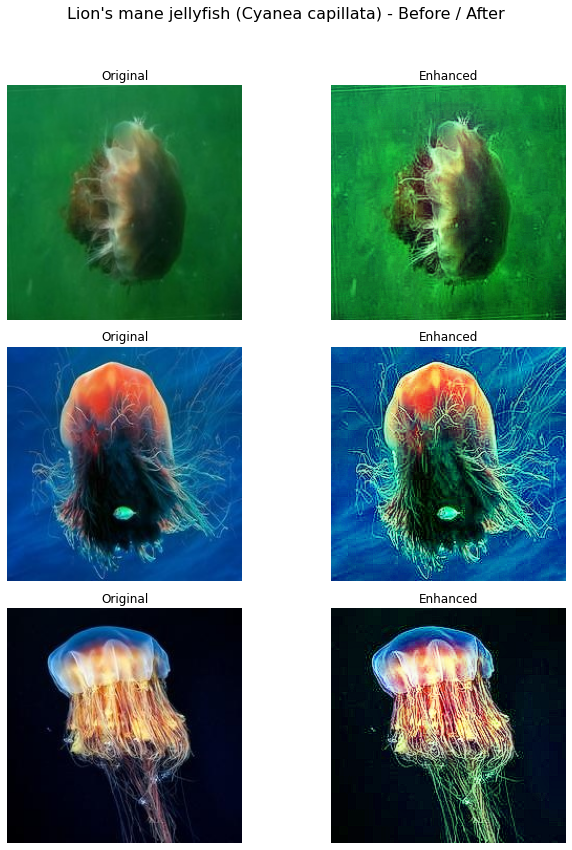

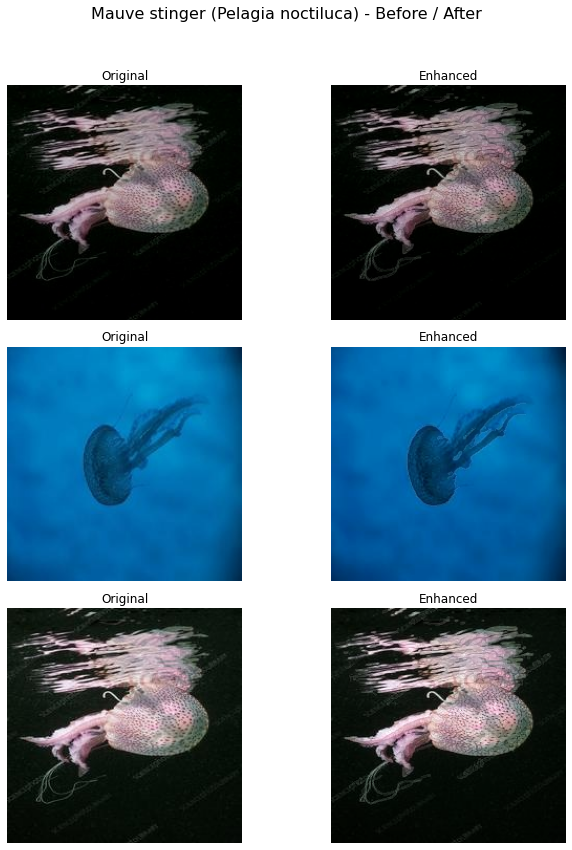

In [16]:
# 객체 생성
augmenter = JellyfishFeaturesAugmentation(p=1.0)  # 항상 적용

# 폴더명 → species 키 매핑 (실제 폴더명과 일치하도록 수정)
folder_to_species_key = {
    'Moon_jellyfish': 'moon',           # 대소문자 맞춤
    'barrel_jellyfish': 'barrel',
    'blue_jellyfish': 'blue',
    'compass_jellyfish': 'compass',
    'lions_mane_jellyfish': 'lions_mane',
    'mauve_stinger_jellyfish': 'mauve_stinger'  # 폴더명에 '_jellyfish' 추가
}

def show_before_after_species(base_dir, samples_per_class=3, figsize=(10, 12)):
    for folder_name in sorted(folder_to_species_key.keys()):
        species_key = folder_to_species_key[folder_name]
        species_dir = os.path.join(base_dir, folder_name)
        
        if not os.path.isdir(species_dir):
            print(f"경고: {species_dir} 폴더가 존재하지 않습니다.")
            continue
        
        img_files = [f for f in os.listdir(species_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        img_files = img_files[:samples_per_class]
        
        if len(img_files) == 0:
            print(f"경고: {species_dir} 폴더에 이미지가 없습니다.")
            continue
        
        plt.figure(figsize=figsize)
        plt.suptitle(f"{augmenter.species_dict[species_key]} - Before / After", fontsize=16)
        
        for i, img_name in enumerate(img_files):
            img_path = os.path.join(species_dir, img_name)
            img = cv2.imread(img_path)
            if img is None:
                print(f"이미지 로드 실패: {img_path}")
                continue
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            # Before
            plt.subplot(samples_per_class, 2, 2*i + 1)
            plt.imshow(img)
            plt.title("Original")
            plt.axis("off")
            
            # After
            enhanced = augmenter.apply(img, species=species_key, intensity=0.4)
            plt.subplot(samples_per_class, 2, 2*i + 2)
            plt.imshow(enhanced)
            plt.title("Enhanced")
            plt.axis("off")
        
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

# 사용
show_before_after_species(base_dir="/aiffel/aiffel/jellyfish", samples_per_class=3)

## 기하학적 증강 (회전 등)

In [17]:
class JellyfishGeometricAugmentation:
    """
    해파리 분류를 위한 기본 기하학적 변환 증강 전략
    방향성이 없는 해파리의 특성을 고려한 회전, 뒤집기, 이동 등 변환
    """

    def __init__(self, p=0.8):
        """
        매개변수:
            p: 증강이 적용될 확률
        """
        self.p = p

    def rotate(self, image, angle_range=(-180, 180)):
        """
        이미지 회전
        해파리는 방향성이 없으므로 완전한 360도 회전 가능

        매개변수:
            image: 입력 이미지
            angle_range: 회전 각도 범위 (기본값: -180 ~ 180도)
        """
        angle = random.uniform(angle_range[0], angle_range[1])
        h, w = image.shape[:2]
        center = (w // 2, h // 2)

        # 회전 행렬 생성
        M = cv2.getRotationMatrix2D(center, angle, 1.0)

        # 회전 적용
        rotated = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)

        return rotated

    def flip(self, image, mode='random'):
        """
        이미지 뒤집기
        해파리는 방향성이 없으므로 수평/수직 모두 자연스러움

        매개변수:
            image: 입력 이미지
            mode: 뒤집기 모드 ('horizontal', 'vertical', 'both', 'random')
        """
        # 모드 선택
        if mode == 'random':
            mode = random.choice(['horizontal', 'vertical', 'both'])

        if mode == 'horizontal':
            flipped = cv2.flip(image, 1)  # 수평 뒤집기
        elif mode == 'vertical':
            flipped = cv2.flip(image, 0)  # 수직 뒤집기
        elif mode == 'both':
            flipped = cv2.flip(image, -1)  # 수평 및 수직 뒤집기
        else:
            flipped = image  # 기본값

        return flipped

    def shift(self, image, shift_range=(-0.2, 0.2)):
        """
        이미지 이동
        해파리는 수중에서 자유롭게 이동하므로 다양한 위치 가능

        매개변수:
            image: 입력 이미지
            shift_range: 이동 범위 비율 (이미지 크기 대비)
        """
        h, w = image.shape[:2]

        # 이동량 계산 (픽셀 단위)
        tx = int(w * random.uniform(shift_range[0], shift_range[1]))
        ty = int(h * random.uniform(shift_range[0], shift_range[1]))

        # 이동 행렬 생성
        M = np.float32([[1, 0, tx], [0, 1, ty]])

        # 이동 적용
        shifted = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)

        return shifted

    def zoom(self, image, zoom_range=(0.8, 1.2)):
        """
        확대/축소
        수중 거리에 따른 해파리 크기 변화 시뮬레이션

        매개변수:
            image: 입력 이미지
            zoom_range: 확대/축소 비율 범위
        """
        h, w = image.shape[:2]

        # 확대/축소 비율 선택
        scale = random.uniform(zoom_range[0], zoom_range[1])

        # 중심점
        center_x, center_y = w // 2, h // 2

        # 변환 행렬 생성
        M = cv2.getRotationMatrix2D((center_x, center_y), 0, scale)

        # 확대/축소 적용
        zoomed = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)

        return zoomed

    def shear(self, image, shear_range=(-0.2, 0.2)):
        """
        전단 변환
        해파리의 유연한 움직임 시뮬레이션

        매개변수:
            image: 입력 이미지
            shear_range: 전단 변환 강도 범위
        """
        h, w = image.shape[:2]

        # 전단 변환 강도 선택
        shear_factor = random.uniform(shear_range[0], shear_range[1])

        # 변환 행렬 생성
        M = np.float32([[1, shear_factor, 0], [0, 1, 0]])

        # 전단 변환 적용
        sheared = cv2.warpAffine(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)

        return sheared

    def elastic_transform(self, image, alpha=50, sigma=5, alpha_affine=20):
        """
        탄성 변환 - OpenCV의 remap 함수를 사용한 새 구현
        해파리의 유연한 움직임과 수축/이완 시뮬레이션

        매개변수:
            image: 입력 이미지
            alpha: 변위 정도
            sigma: 변위의 평활도
            alpha_affine: 아핀 변환 정도
        """
        # 이미지 크기
        height, width = image.shape[:2]

        # 임의의 변위 필드 생성
        random_state = np.random.RandomState(None)
        dx = random_state.rand(height, width) * 2 - 1
        dy = random_state.rand(height, width) * 2 - 1

        # 가우시안 필터로 변위 필드 스무딩
        dx = cv2.GaussianBlur(dx.astype(np.float32), (0, 0), sigma) * alpha
        dy = cv2.GaussianBlur(dy.astype(np.float32), (0, 0), sigma) * alpha

        # 좌표 매핑을 위한 meshgrid 생성
        x, y = np.meshgrid(np.arange(width), np.arange(height))

        # 변위 필드 적용
        map_x = np.clip(x + dx, 0, width - 1).astype(np.float32)
        map_y = np.clip(y + dy, 0, height - 1).astype(np.float32)

        # remap 함수를 사용하여 이미지 변형
        distorted = cv2.remap(image, map_x, map_y,
                             interpolation=cv2.INTER_LINEAR,
                             borderMode=cv2.BORDER_REFLECT_101)

        return distorted

    def radial_distortion(self, image, distortion_range=(-0.3, 0.3)):
        """
        방사형 왜곡
        수중 촬영 시 발생하는 렌즈 왜곡 시뮬레이션

        매개변수:
            image: 입력 이미지
            distortion_range: 왜곡 강도 범위
        """
        h, w = image.shape[:2]

        # 왜곡 계수 선택
        k = random.uniform(distortion_range[0], distortion_range[1])

        # 이미지 중심점
        cx, cy = w / 2, h / 2

        # 새 이미지 생성
        distorted = np.zeros_like(image)

        # 각 픽셀에 왜곽 적용
        for y in range(h):
            for x in range(w):
                # 중심으로부터의 정규화된 좌표
                nx = (x - cx) / cx
                ny = (y - cy) / cy

                # 반지름
                r = np.sqrt(nx**2 + ny**2)

                # 방사형 왜곡 적용
                if r > 0:
                    theta = np.arctan2(ny, nx)
                    r_distorted = r * (1 + k * r**2)

                    # 왜곡된 좌표
                    dx = cx + cx * r_distorted * np.cos(theta)
                    dy = cy + cy * r_distorted * np.sin(theta)

                    # 범위 내에 있는지 확인
                    if 0 <= dx < w and 0 <= dy < h:
                        # 이중 선형 보간
                        x1, y1 = int(dx), int(dy)
                        x2, y2 = min(x1 + 1, w - 1), min(y1 + 1, h - 1)

                        # 가중치
                        wx = dx - x1
                        wy = dy - y1

                        # 이중 선형 보간으로 픽셀값 계산
                        for c in range(3):  # RGB 채널
                            value = (1 - wx) * (1 - wy) * image[y1, x1, c] + \
                                    wx * (1 - wy) * image[y1, x2, c] + \
                                    (1 - wx) * wy * image[y2, x1, c] + \
                                    wx * wy * image[y2, x2, c]
                            distorted[y, x, c] = value

        return distorted

    def perspective_transform(self, image, intensity=0.1):
        """
        원근 변환
        다양한 시점에서 촬영된 해파리 시뮬레이션

        매개변수:
            image: 입력 이미지
            intensity: 변환 강도
        """
        h, w = image.shape[:2]

        # 원본 이미지의 코너 좌표
        pts1 = np.float32([[0, 0], [w, 0], [0, h], [w, h]])

        # 변환될 좌표 (약간의 랜덤 변위 추가)
        shift = w * intensity
        pts2 = np.float32([
            [random.uniform(0, shift), random.uniform(0, shift)],
            [random.uniform(w - shift, w), random.uniform(0, shift)],
            [random.uniform(0, shift), random.uniform(h - shift, h)],
            [random.uniform(w - shift, w), random.uniform(h - shift, h)]
        ])

        # 변환 행렬 및 적용
        M = cv2.getPerspectiveTransform(pts1, pts2)
        warped = cv2.warpPerspective(image, M, (w, h), borderMode=cv2.BORDER_REFLECT)

        return warped

    def center_crop_and_resize(self, image, crop_percent=0.8):
        """
        중앙 크롭 및 리사이즈
        해파리가 항상 이미지 중앙에 위치하도록 조정

        매개변수:
            image: 입력 이미지
            crop_percent: 원본 대비 크롭 비율
        """
        h, w = image.shape[:2]

        # 크롭 크기 계산
        crop_h = int(h * crop_percent)
        crop_w = int(w * crop_percent)

        # 중앙 좌표 계산
        start_y = (h - crop_h) // 2
        start_x = (w - crop_w) // 2

        # 크롭 적용
        cropped = image[start_y:start_y+crop_h, start_x:start_x+crop_w]

        # 원본 크기로 리사이즈
        resized = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)

        return resized

    def random_resize(self, image, scale_range=(0.7, 1.3)):
        """
        랜덤 리사이즈
        다양한 크기의 해파리 시뮬레이션

        매개변수:
            image: 입력 이미지
            scale_range: 스케일 범위
        """
        h, w = image.shape[:2]

        # 스케일 선택
        scale = random.uniform(scale_range[0], scale_range[1])

        # 새 크기 계산
        new_h = int(h * scale)
        new_w = int(w * scale)

        # 리사이즈
        resized = cv2.resize(image, (new_w, new_h), interpolation=cv2.INTER_LINEAR)

        # 원본 크기에 맞게 캔버스 생성
        result = np.zeros_like(image)

        # 중앙 위치 계산
        start_y = max(0, (h - new_h) // 2)
        start_x = max(0, (w - new_w) // 2)

        # 이미지가 원본보다 작은 경우
        if new_h <= h and new_w <= w:
            result[start_y:start_y+new_h, start_x:start_x+new_w] = resized
        else:
            # 이미지가 원본보다 큰 경우 중앙 부분 크롭
            crop_y = max(0, (new_h - h) // 2)
            crop_x = max(0, (new_w - w) // 2)
            crop_h = min(new_h, h)
            crop_w = min(new_w, w)

            result = resized[crop_y:crop_y+crop_h, crop_x:crop_x+crop_w]

            # 크기 조정이 필요한 경우
            if result.shape[:2] != (h, w):
                result = cv2.resize(result, (w, h), interpolation=cv2.INTER_LINEAR)

        return result

    def apply(self, image, transformations=None):
        """
        선택한 변환들을 이미지에 적용

        매개변수:
            image: 입력 이미지
            transformations: 적용할 변환 목록 (None이면 무작위 선택)
        """
        if random.random() > self.p:
            return image

        result = image.copy()

        # 모든 가능한 변환
        all_transformations = [
            'rotate', 'flip', 'shift', 'zoom', 'shear',
            'elastic', 'radial', 'perspective', 'crop_resize', 'random_resize'
        ]

        # 변환이 지정되지 않은 경우 무작위 선택 (2-4개)
        if transformations is None:
            num_transforms = random.randint(2, 4)
            transformations = random.sample(all_transformations, num_transforms)

        # 변환 적용
        for transform in transformations:
            try:
                if transform == 'rotate':
                    result = self.rotate(result)
                elif transform == 'flip':
                    result = self.flip(result)
                elif transform == 'shift':
                    result = self.shift(result)
                elif transform == 'zoom':
                    result = self.zoom(result)
                elif transform == 'shear':
                    result = self.shear(result)
                elif transform == 'elastic':
                    # 탄성 변환은 계산 비용이 높아 낮은 확률로 적용
                    if random.random() < 0.3:
                        result = self.elastic_transform(result)
                elif transform == 'radial':
                    # 방사형 왜곡은 계산 비용이 높아 낮은 확률로 적용
                    if random.random() < 0.2:
                        result = self.radial_distortion(result)
                elif transform == 'perspective':
                    result = self.perspective_transform(result)
                elif transform == 'crop_resize':
                    result = self.center_crop_and_resize(result)
                elif transform == 'random_resize':
                    result = self.random_resize(result)
            except Exception as e:
                print(f"Error applying {transform} transformation: {str(e)}")
                # 오류 발생 시 원본 이미지 유지
                continue

        return result

    def visualize_transformations(self, image, figsize=(15, 12)):
        """
        각 변환의 효과 시각화

        매개변수:
            image: 입력 이미지
            figsize: 그림 크기
        """
        transformations = [
            ("Original", lambda x: x),
            ("Rotation", self.rotate),
            ("Flip", self.flip),
            ("Shift", self.shift),
            ("Zoom", self.zoom),
            ("Shear", self.shear),
            ("Elastic Transform", lambda x: self.elastic_transform(x)),
            ("Radial Distortion", self.radial_distortion),
            ("Perspective", self.perspective_transform),
            ("Center Crop & Resize", self.center_crop_and_resize),
            ("Random Resize", self.random_resize),
            ("Combined (Random)", lambda x: self.apply(x, transformations=['rotate', 'flip', 'shift', 'zoom']))
        ]

        plt.figure(figsize=figsize)

        for i, (name, transform_func) in enumerate(transformations):
            plt.subplot(3, 4, i + 1)

            try:
                transformed = transform_func(image.copy())
                plt.imshow(transformed)
                plt.title(name)
            except Exception as e:
                plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                plt.title(f"{name} (Error)")

            plt.axis('off')

        plt.tight_layout()
        plt.show()

    def visualize_intensity(self, image, transform_type, param_name, values, figsize=(15, 8)):
        """
        특정 변환의 다양한 강도 시각화

        매개변수:
            image: 입력 이미지
            transform_type: 변환 타입 ('rotate', 'zoom', 등)
            param_name: 매개변수 이름
            values: 매개변수 값 목록
            figsize: 그림 크기
        """
        plt.figure(figsize=figsize)

        # 원본 이미지 표시
        plt.subplot(2, 4, 1)
        plt.imshow(image)
        plt.title("Original")
        plt.axis('off')

        # 각 강도 수준 시각화
        for i, value in enumerate(values):
            plt.subplot(2, 4, i + 2)

            try:
                if transform_type == 'rotate':
                    if param_name == 'angle':
                        transformed = self.rotate(image.copy(), angle_range=(value, value))
                elif transform_type == 'zoom':
                    if param_name == 'scale':
                        transformed = self.zoom(image.copy(), zoom_range=(value, value))
                elif transform_type == 'elastic':
                    if param_name == 'alpha':
                        transformed = self.elastic_transform(image.copy(), alpha=value)
                    elif param_name == 'sigma':
                        transformed = self.elastic_transform(image.copy(), sigma=value)
                elif transform_type == 'perspective':
                    if param_name == 'intensity':
                        transformed = self.perspective_transform(image.copy(), intensity=value)

                plt.imshow(transformed)
                plt.title(f"{param_name}: {value}")
            except Exception as e:
                plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                plt.title(f"{param_name}: {value} (Error)")

            plt.axis('off')

        plt.suptitle(f"{transform_type.capitalize()} Transformation Intensity", fontsize=16)
        plt.tight_layout()
        plt.show()

# base_dir 설정 및 경로 확인
base_dir = "/aiffel/aiffel/jellyfish"  # Cloud Shell에서 확인한 경로
if not os.path.exists(base_dir):
    print(f"오류: {base_dir} 경로가 존재하지 않습니다. 경로를 확인하세요.")
    raise FileNotFoundError(f"{base_dir} not found")

print("현재 디렉토리:", os.getcwd())
print("작업 디렉토리:", base_dir)

# 현재 디렉토리에서 '클래스 폴더'만 추출
exclude_dirs = ['Train_Test_Valid', '__MACOSX', '.ipynb_checkpoints']
class_dirs = [d for d in os.listdir('.') if os.path.isdir(d) and d not in exclude_dirs and not d.endswith('.zip')]

print(f"클래스 개수: {len(class_dirs)}")
print("클래스 목록:")
for cls in class_dirs:
    print(f" - {cls}")

# 테스트 이미지 로드 (예시)
test_image_path = os.path.join(base_dir, "Jellyfish1.jpeg")  # 실제 이미지 경로로 변경
if os.path.exists(test_image_path):
    test_image = cv2.imread(test_image_path)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)  # OpenCV는 BGR 사용

    # 증강 클래스 인스턴스 생성 및 시각화
    augmenter = JellyfishGeometricAugmentation()
    augmenter.visualize_transformations(test_image)
    augmenter.visualize_intensity(test_image, 'rotate', 'angle', [-90, -45, 0, 45, 90])
    augmenter.visualize_intensity(test_image, 'zoom', 'scale', [0.7, 0.85, 1.0, 1.15, 1.3])
    augmenter.visualize_intensity(test_image, 'elastic', 'alpha', [20, 30, 40, 50, 60])
    augmenter.visualize_intensity(test_image, 'elastic', 'sigma', [3, 4, 5, 6, 7])
    augmenter.visualize_intensity(test_image, 'perspective', 'intensity', [0.05, 0.1, 0.15, 0.2, 0.25])
else:
    print(f"테스트 이미지 파일이 없습니다: {test_image_path}")

현재 디렉토리: /aiffel/aiffel
작업 디렉토리: /aiffel/aiffel/jellyfish
클래스 개수: 14
클래스 목록:
 - lost+found
 - folder
 - data_represent
 - Jellyfish
 - pokemon_eda
 - workplace
 - new_folding
 - project
 - fastAPI
 - data_visualization
 - jellyfish
 - chest_xray
 - fold
 - cifar_10_small
테스트 이미지 파일이 없습니다: /aiffel/aiffel/jellyfish/Jellyfish1.jpeg


In [18]:
import os

print(os.getcwd())

/aiffel/aiffel


Showing augmentations for: ./jellyfish/Train_Test_Valid/Train/barrel_jellyfish


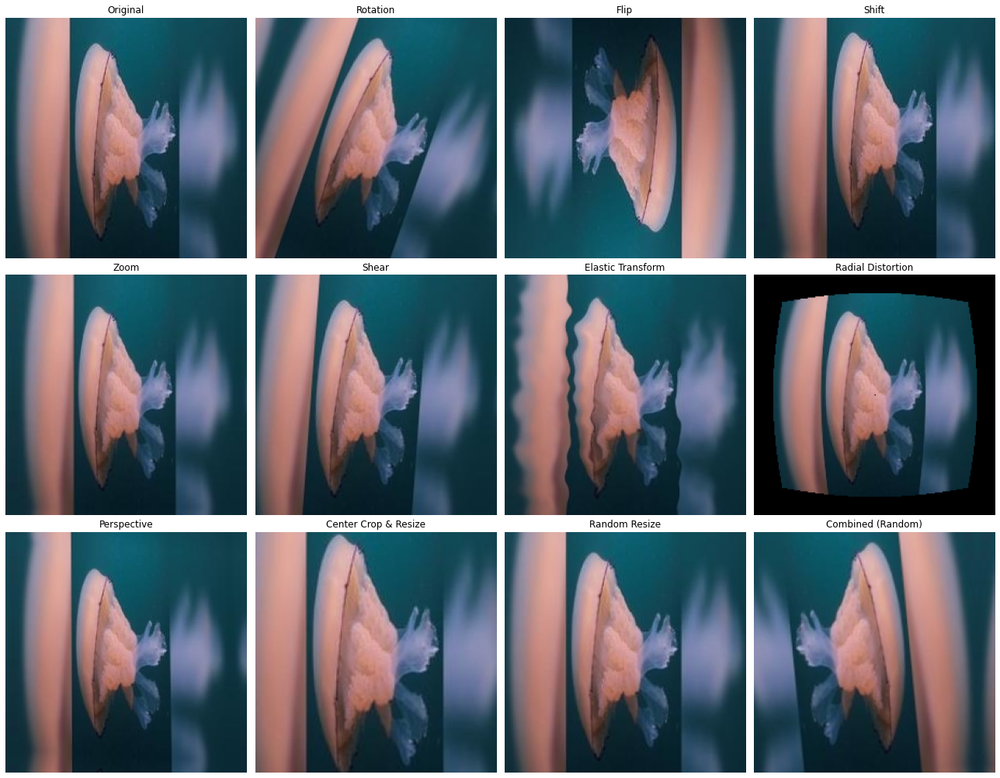

Showing augmentations for: ./jellyfish/Train_Test_Valid/Train/blue_jellyfish


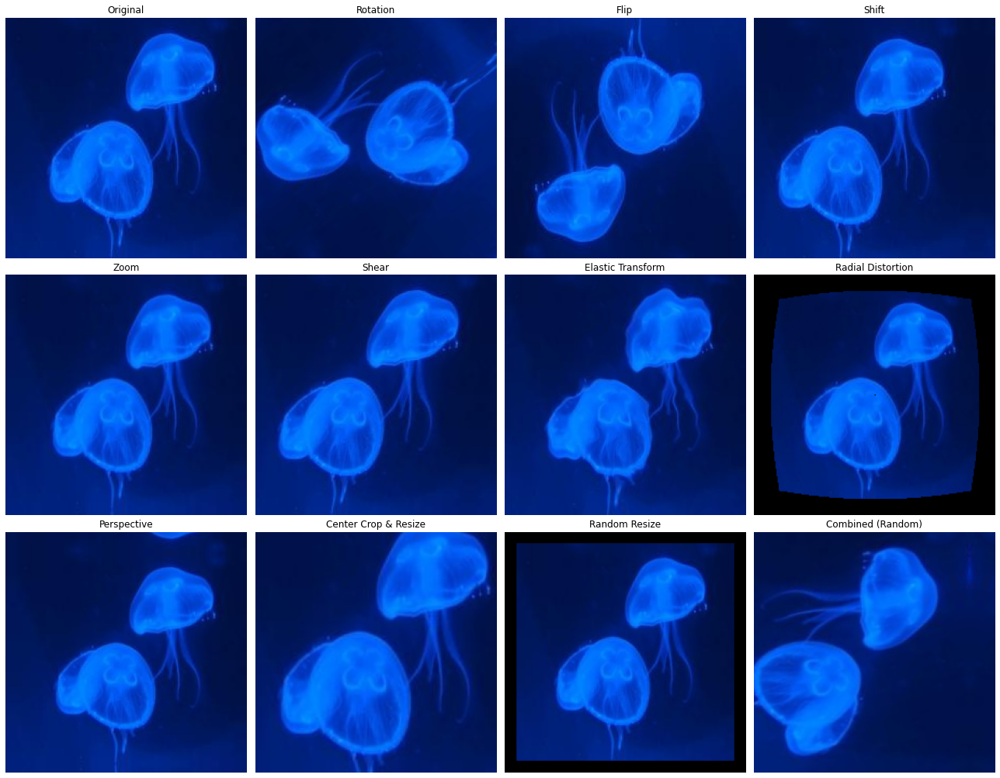

Showing augmentations for: ./jellyfish/Train_Test_Valid/Train/compass_jellyfish


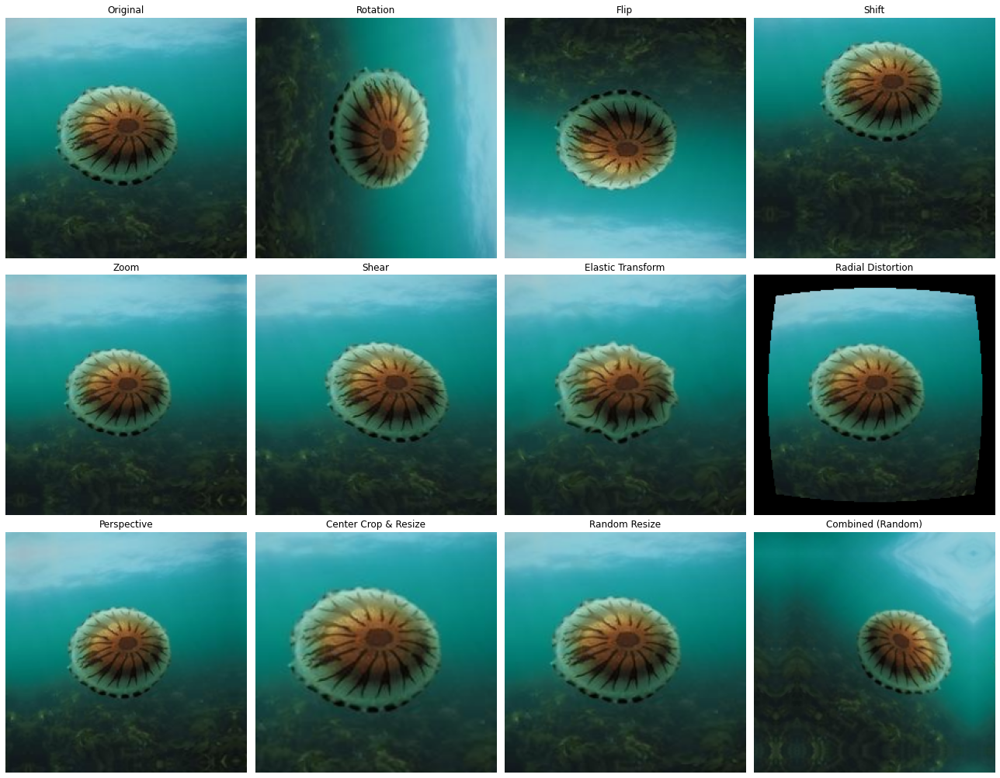

Showing augmentations for: ./jellyfish/Train_Test_Valid/Train/lions_mane_jellyfish


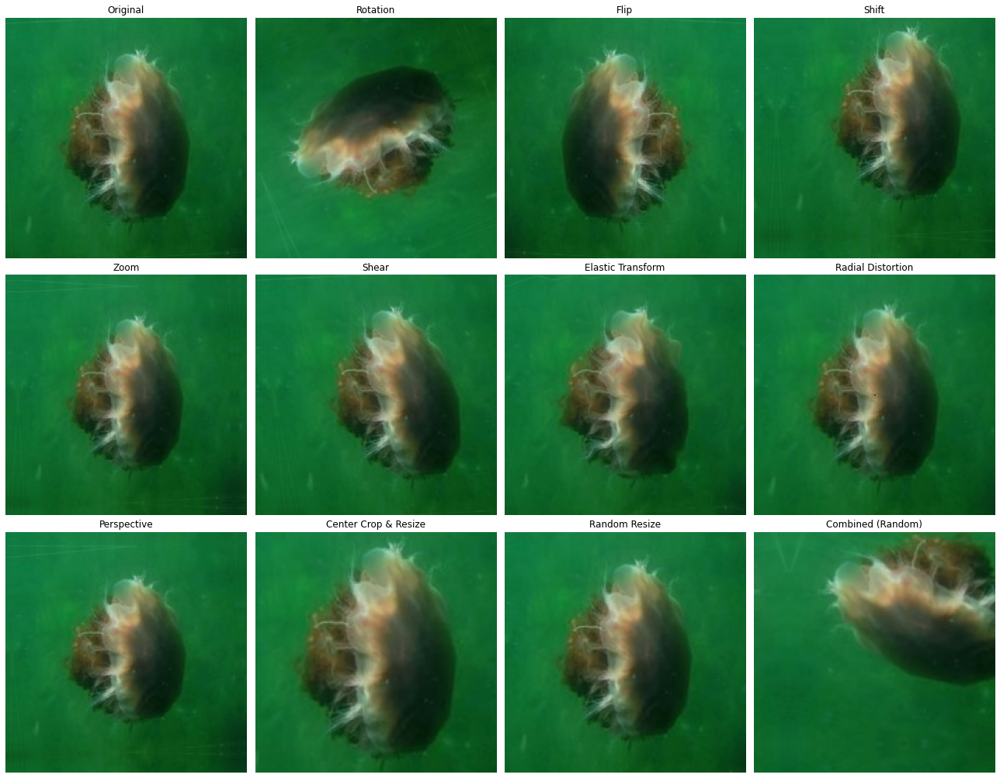

Showing augmentations for: ./jellyfish/Train_Test_Valid/Train/mauve_stinger_jellyfish


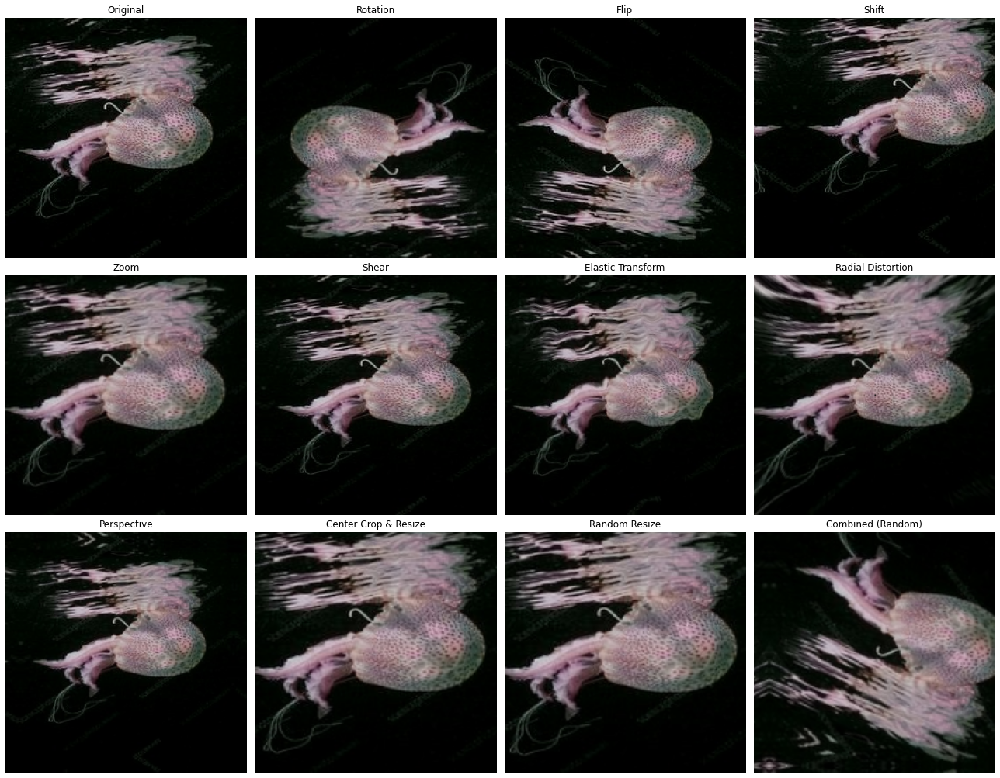

Showing augmentations for: ./jellyfish/Train_Test_Valid/Train/Moon_jellyfish


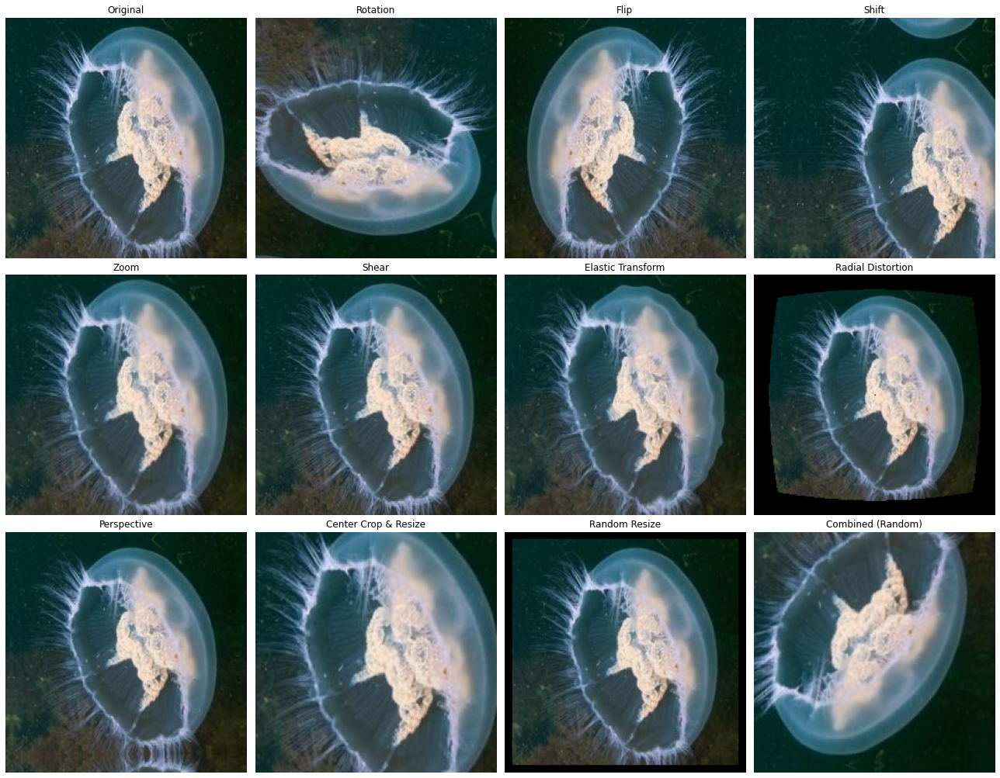

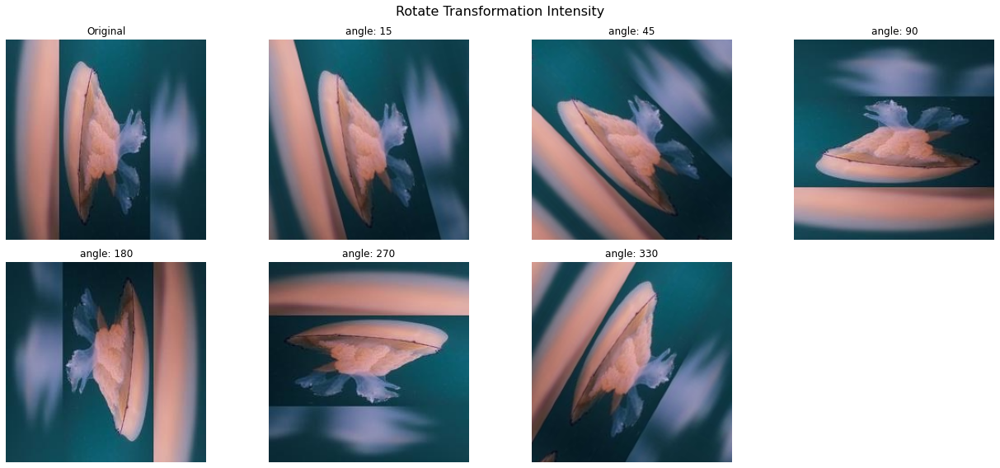

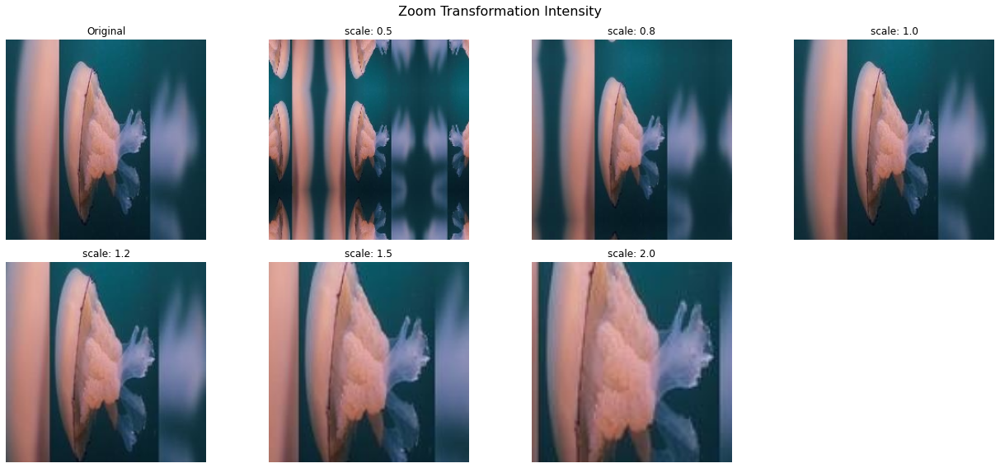

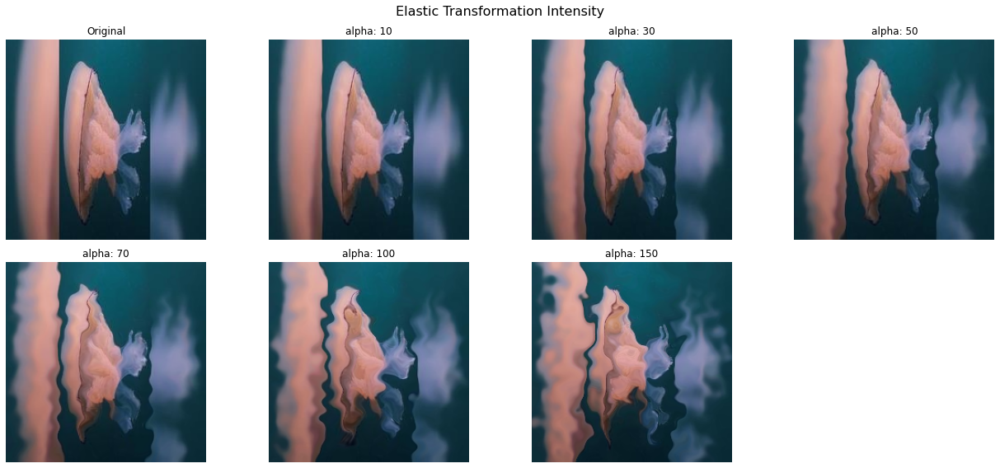

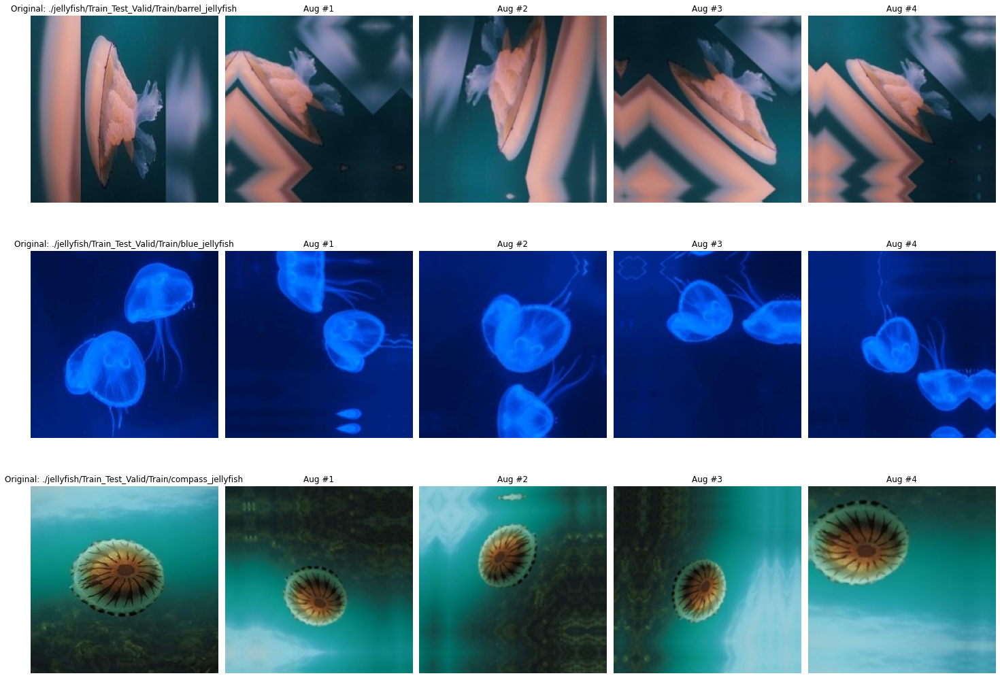

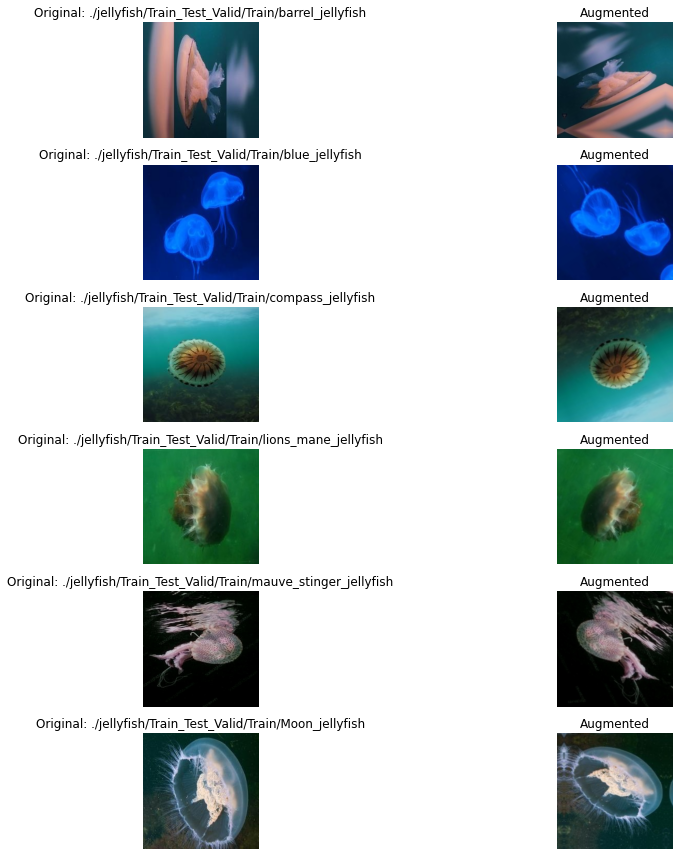

In [19]:
# JellyfishGeometricAugmentation 클래스 인스턴스 생성
augmenter = JellyfishGeometricAugmentation(p=1.0)  # p=1.0으로 설정하여 항상 증강 적용

# 이미지 파일 경로 수정
species = [
    "./jellyfish/Train_Test_Valid/Train/barrel_jellyfish",
    "./jellyfish/Train_Test_Valid/Train/blue_jellyfish",
    "./jellyfish/Train_Test_Valid/Train/compass_jellyfish",
    "./jellyfish/Train_Test_Valid/Train/lions_mane_jellyfish",
    "./jellyfish/Train_Test_Valid/Train/mauve_stinger_jellyfish",
    "./jellyfish/Train_Test_Valid/Train/Moon_jellyfish"
]

# 시각화할 이미지 목록 생성
sample_images = []
for jellyfish_type in species:
    img_path = jellyfish_type
    try:
        files = os.listdir(img_path)
        if files:
            # 각 종류별로 첫 번째 이미지 선택
            image_path = os.path.join(img_path, files[0])
            image = cv2.imread(image_path)
            if image is None:
                print(f"Failed to load image: {image_path}")
                continue
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR에서 RGB로 변환
            sample_images.append((jellyfish_type, image))
    except Exception as e:
        print(f"Error loading images for {jellyfish_type}: {str(e)}")

if not sample_images:
    print("No images could be loaded. Please check the directory paths.")
else:
    # 1. 모든 증강 기법 시각화
    for species_name, img in sample_images:
        print(f"Showing augmentations for: {species_name}")
        augmenter.visualize_transformations(img, figsize=(18, 14))

    # 2. 특정 증강의 강도별 효과 시각화
    sample_img = sample_images[0][1]  # 첫 번째 해파리 이미지 사용

    # 회전 강도 시각화
    try:
        augmenter.visualize_intensity(
            sample_img,
            transform_type='rotate',
            param_name='angle',
            values=[15, 45, 90, 180, 270, 330],
            figsize=(18, 8)
        )
    except Exception as e:
        print(f"Error visualizing rotation intensity: {str(e)}")

    # 확대/축소 강도 시각화
    try:
        augmenter.visualize_intensity(
            sample_img,
            transform_type='zoom',
            param_name='scale',
            values=[0.5, 0.8, 1.0, 1.2, 1.5, 2.0],
            figsize=(18, 8)
        )
    except Exception as e:
        print(f"Error visualizing zoom intensity: {str(e)}")

    # 탄성 변환 강도 시각화
    try:
        augmenter.visualize_intensity(
            sample_img,
            transform_type='elastic',
            param_name='alpha',
            values=[10, 30, 50, 70, 100, 150],
            figsize=(18, 8)
        )
    except Exception as e:
        print(f"Error visualizing elastic intensity: {str(e)}")

    # 3. 증강 결과 그리드 시각화 (여러 이미지에 대한 동일 증강 효과)
    def visualize_augmentation_grid(images, augmenter, n_samples=4, figsize=(20, 15)):
        """
        여러 이미지에 대한 증강 효과를 그리드로 시각화

        매개변수:
            images: (이름, 이미지) 튜플의 리스트
            augmenter: 증강기 객체
            n_samples: 각 이미지별 생성할 증강 샘플 수
            figsize: 그림 크기
        """
        n_images = len(images)

        plt.figure(figsize=figsize)

        for i, (name, img) in enumerate(images):
            # 원본 이미지
            plt.subplot(n_images, n_samples + 1, i * (n_samples + 1) + 1)
            plt.imshow(img)
            plt.title(f"Original: {name}")
            plt.axis('off')

            # 증강된 샘플들
            for j in range(n_samples):
                plt.subplot(n_images, n_samples + 1, i * (n_samples + 1) + j + 2)

                try:
                    # 안전한 변환만 사용 (elastic 제외)
                    augmented = augmenter.apply(img.copy(),
                                                transformations=['rotate', 'flip', 'shift', 'zoom', 'perspective'])

                    plt.imshow(augmented)
                    plt.title(f"Aug #{j+1}")
                except Exception as e:
                    plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                    plt.title(f"Aug #{j+1} (Error)")

                plt.axis('off')

        plt.tight_layout()
        plt.show()

    # 처음 3개 해파리 종류만 선택하여 증강 그리드 시각화
    try:
        visualize_augmentation_grid(sample_images[:3], augmenter, n_samples=4)
    except Exception as e:
        print(f"Error visualizing augmentation grid: {str(e)}")

    # 4. 증강 전/후 비교 시각화
    def visualize_before_after(images, augmenter, figsize=(16, 12)):
        """
        원본 이미지와 증강된 이미지를 나란히 비교 시각화

        매개변수:
            images: (이름, 이미지) 튜플의 리스트
            augmenter: 증강기 객체
            figsize: 그림 크기
        """
        n_images = len(images)

        plt.figure(figsize=figsize)

        for i, (name, img) in enumerate(images):
            # 원본 이미지
            plt.subplot(n_images, 2, 2*i + 1)
            plt.imshow(img)
            plt.title(f"Original: {name}")
            plt.axis('off')

            # 증강된 이미지
            plt.subplot(n_images, 2, 2*i + 2)

            try:
                # 안전한 변환 적용
                augmented = augmenter.apply(img.copy(),
                                            transformations=['rotate', 'flip', 'zoom'])
                plt.imshow(augmented)
                plt.title("Augmented")
            except Exception as e:
                plt.text(0.5, 0.5, f"Error: {str(e)}", ha='center', va='center')
                plt.title("Augmented (Error)")

            plt.axis('off')

        plt.tight_layout()
        plt.show()

    # 모든 해파리 종류에 대해 전/후 비교 시각화
    try:
        visualize_before_after(sample_images, augmenter)
    except Exception as e:
        print(f"Error visualizing before/after comparison: {str(e)}")

## 노이즈 추가

Visualizing effect of different bubble densities


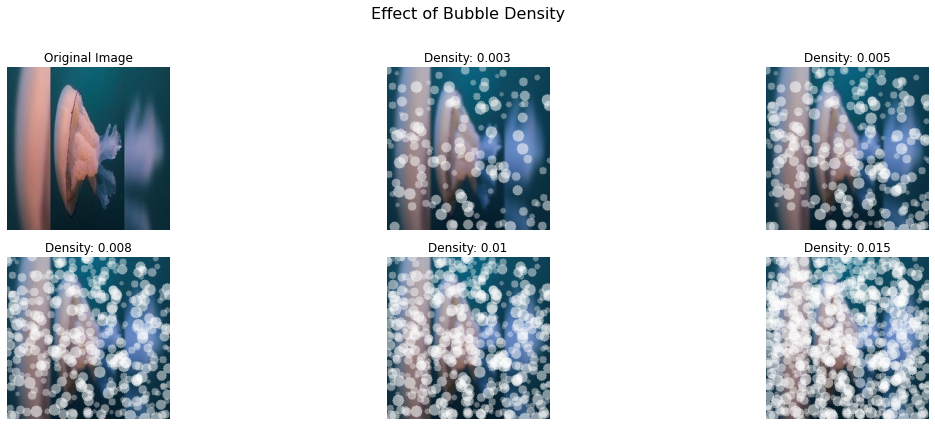

Applying improved underwater effect to all jellyfish species


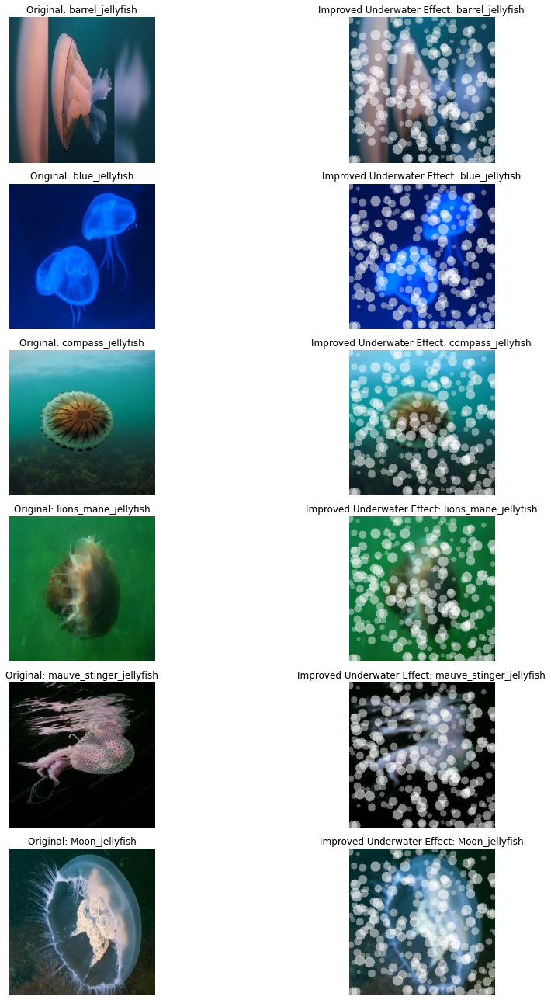

Visualizing different bubble size distributions


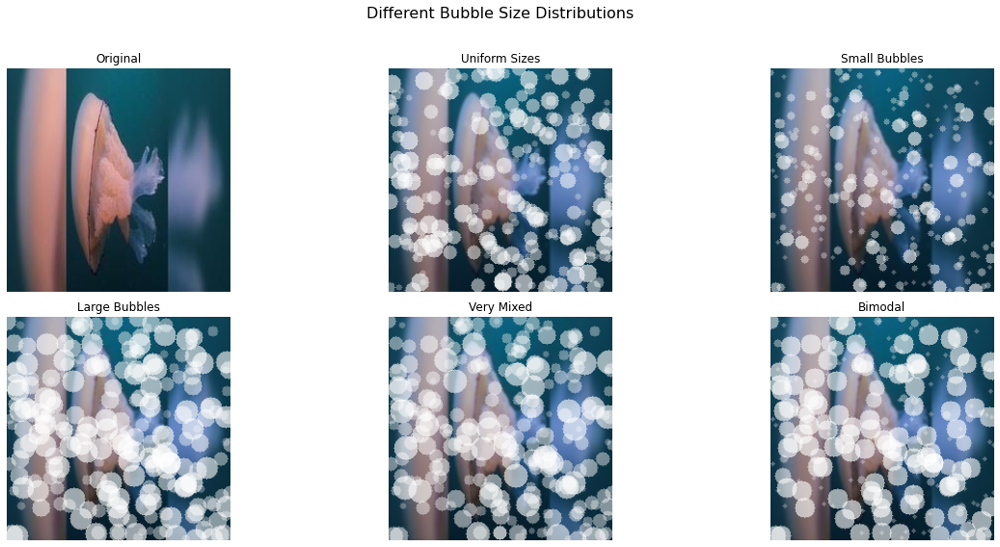

In [20]:
# 한글 폰트 경고 방지를 위해 영문만 사용
mpl.rcParams['font.family'] = 'DejaVu Sans'

def underwater_effect(image, blue_tint=0.2, blur_level=1.0, bubble_density=0.005, min_radius=3, max_radius=8):
    """Apply underwater effect simulation to an image with improved bubbles
    Args:
        image: Original image (float32 in 0-1 range)
        blue_tint: Blue tint intensity (0-1)
        blur_level: Blur intensity (0-3)
        bubble_density: Bubble effect density (0-0.05)
        min_radius: Minimum bubble radius
        max_radius: Maximum bubble radius
    
    Returns:
        underwater_img: Image with underwater effect applied
    """
    # Copy image
    img = image.copy()
    
    # 1. Add blue tint (red disappears first underwater)
    if len(img.shape) == 3:
        # Reduce R channel
        img[:,:,0] = img[:,:,0] * (1 - blue_tint)
        # Increase B channel
        img[:,:,2] = np.clip(img[:,:,2] * (1 + blue_tint/2), 0, 1)
    
    # 2. Apply Gaussian blur (simulate underwater turbidity)
    if blur_level > 0:
        kernel_size = int(blur_level * 3) * 2 + 1  # Always make it odd
        img = cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    
    # 3. Add bubble effect with transparency and varied sizes
    if bubble_density > 0:
        h, w = img.shape[0], img.shape[1]
        n_bubbles = int(h * w * bubble_density)  # Reduced density
        
        for _ in range(n_bubbles):
            # Random position
            x = np.random.randint(0, w)
            y = np.random.randint(0, h)
            
            # Random size, skewed toward larger bubbles
            # Using a weighted distribution for radius - more medium/large, fewer tiny bubbles
            size_distribution = np.array([0.1, 0.15, 0.2, 0.2, 0.2, 0.15])  # Weights for sizes
            size_indices = np.arange(min_radius, min_radius + len(size_distribution))
            radius = np.random.choice(size_indices, p=size_distribution)
            
            # Random opacity, higher for larger bubbles
            base_opacity = 0.3
            size_factor = (radius - min_radius) / (max_radius - min_radius)
            opacity = base_opacity + size_factor * 0.3  # 0.3 to 0.6 opacity range
            
            # Draw bubble with transparency
            if len(img.shape) == 3:
                # Create a bubble overlay
                overlay = img.copy()
                # Draw the bubble on the overlay
                cv2.circle(overlay, (x, y), radius, (1, 1, 1), -1)
                # Blend the overlay with original image using opacity
                img = cv2.addWeighted(overlay, opacity, img, 1 - opacity, 0)
    
    return img

# Apply the improved underwater effect to all jellyfish images
def visualize_improved_effect(base_dir, species):
    """
    Apply the improved underwater effect to all jellyfish species images
    
    Args:
        base_dir: Base dataset directory
        species: List of jellyfish species
    """
    # Load sample images
    sample_images = []
    for jellyfish_type in species:
        img_path = os.path.join(base_dir, "Train_Test_Valid/Train", jellyfish_type) #경로수정
        try:
            files = os.listdir(img_path)
            if files:
                # Choose first image from each species
                image_path = os.path.join(img_path, files[0])
                image = cv2.imread(image_path)
                if image is None:
                    print(f"Failed to load image: {image_path}")
                    continue
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
                image = image.astype(np.float32) / 255.0  # Normalize to 0-1 range
                sample_images.append((jellyfish_type, image))
        except Exception as e:
            print(f"Error loading images for {jellyfish_type}: {str(e)}")
    
    if not sample_images:
        print("No images could be loaded. Please check the directory paths.")
        return
    
    # Apply improved underwater effect
    plt.figure(figsize=(16, 3 * len(sample_images)))
    
    for i, (name, img) in enumerate(sample_images):
        # Original image
        plt.subplot(len(sample_images), 2, 2*i + 1)
        plt.imshow(img)
        plt.title(f"Original: {name}")
        plt.axis('off')
        
        # Apply improved underwater effect
        plt.subplot(len(sample_images), 2, 2*i + 2)
        np.random.seed(42)  # For consistent bubble placement
        underwater_img = underwater_effect(
            img,
            blue_tint=0.2,
            blur_level=1.0,
            bubble_density=0.005,  # Reduced density
            min_radius=3,          # Minimum radius
            max_radius=9           # Maximum radius
        )
        plt.imshow(underwater_img)
        plt.title(f"Improved Underwater Effect: {name}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    np.random.seed(None)  # Reset random seed

# Visualize different bubble density settings
def visualize_bubble_density(image_path):
    """
    Visualize the impact of different bubble density settings
    
    Args:
        image_path: Path to the image
    """
    # Load image
    img = cv2.imread(image_path)
    if img is None:
        print(f"Failed to load image: {image_path}")
        return
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    img = img.astype(np.float32) / 255.0      # Normalize to 0-1 range
    
    # Define density settings to test
    densities = [0.001, 0.003, 0.005, 0.008, 0.01, 0.015]
    
    plt.figure(figsize=(18, 6))
    plt.suptitle("Effect of Bubble Density", fontsize=16)
    
    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(img)
    plt.title("Original Image")
    plt.axis('off')
    
    # Apply different densities
    for i, density in enumerate(densities[1:]):
        plt.subplot(2, 3, i+2)
        np.random.seed(42)  # Consistent bubble placement
        result = underwater_effect(
            img,
            blue_tint=0.2,
            blur_level=1.0,
            bubble_density=density,
            min_radius=3,
            max_radius=9
        )
        plt.imshow(result)
        plt.title(f"Density: {density}")
        plt.axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
    np.random.seed(None)  # Reset random seed

# Main code
if __name__ == "__main__":
    # Set base path
    base_dir = "./jellyfish" #경로수정
    species = ["barrel_jellyfish", "blue_jellyfish", "compass_jellyfish", "lions_mane_jellyfish",
                "mauve_stinger_jellyfish", "Moon_jellyfish"] # 경로수정

    # Get first jellyfish image path
    try:
        first_species = species[0]
        img_path = os.path.join(base_dir, "Train_Test_Valid/Train", first_species) #경로수정
        files = os.listdir(img_path)
        if files:
            first_image_path = os.path.join(img_path, files[0])
            
            # 1. Visualize different bubble densities
            print(f"Visualizing effect of different bubble densities")
            visualize_bubble_density(first_image_path)
            
            # 2. Apply improved effect to all species
            print(f"Applying improved underwater effect to all jellyfish species")
            visualize_improved_effect(base_dir, species)
            
            # 3. Generate a few examples with different bubble size distributions
            def visualize_bubble_size_distributions(image_path):
                """Visualize different bubble size distributions"""
                # Load image
                img = cv2.imread(image_path)
                if img is None:
                    print(f"Failed to load image: {image_path}")
                    return
                
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = img.astype(np.float32) / 255.0
                
                plt.figure(figsize=(18, 8))
                plt.suptitle("Different Bubble Size Distributions", fontsize=16)
                
                # Original
                plt.subplot(2, 3, 1)
                plt.imshow(img)
                plt.title("Original")
                plt.axis('off')
                
                # Apply underwater effect with different bubble size distributions
                distributions = [
                    {"name": "Uniform Sizes", "weights": None, "min_r": 3, "max_r": 9},
                    {"name": "Small Bubbles", "weights": [0.3, 0.3, 0.2, 0.1, 0.1], "min_r": 2, "max_r": 7},
                    {"name": "Large Bubbles", "weights": [0.1, 0.1, 0.2, 0.3, 0.3], "min_r": 4, "max_r": 11},
                    {"name": "Very Mixed", "weights": [0.1, 0.2, 0.4, 0.2, 0.1], "min_r": 3, "max_r": 12},
                    {"name": "Bimodal", "weights": [0.4, 0.1, 0.0, 0.1, 0.4], "min_r": 2, "max_r": 10}
                ]
                
                for i, dist in enumerate(distributions):
                    plt.subplot(2, 3, i+2)
                    np.random.seed(42)
                    
                    # Apply blue tint and blur
                    result = img.copy()
                    result[:,:,0] = result[:,:,0] * 0.8  # Reduce red
                    result[:,:,2] = np.clip(result[:,:,2] * 1.1, 0, 1)  # Boost blue
                    result = cv2.GaussianBlur(result, (5, 5), 0)
                    
                    # Add bubbles with specified size distribution
                    h, w = result.shape[0], result.shape[1]
                    n_bubbles = int(h * w * 0.005)  # 0.5% density
                    
                    if dist["weights"] is None:
                        # Uniform distribution
                        for _ in range(n_bubbles):
                            x = np.random.randint(0, w)
                            y = np.random.randint(0, h)
                            radius = np.random.randint(dist["min_r"], dist["max_r"]+1)
                            opacity = 0.3 + (radius - dist["min_r"]) / (dist["max_r"] - dist["min_r"]) * 0.3
                            
                            overlay = result.copy()
                            cv2.circle(overlay, (x, y), radius, (1, 1, 1), -1)
                            result = cv2.addWeighted(overlay, opacity, result, 1 - opacity, 0)
                    else:
                        # Weighted distribution
                        size_range = np.linspace(dist["min_r"], dist["max_r"], len(dist["weights"]), dtype=int)
                        
                        for _ in range(n_bubbles):
                            x = np.random.randint(0, w)
                            y = np.random.randint(0, h)
                            radius = np.random.choice(size_range, p=dist["weights"])
                            opacity = 0.3 + (radius - dist["min_r"]) / (dist["max_r"] - dist["min_r"]) * 0.3
                            
                            overlay = result.copy()
                            cv2.circle(overlay, (x, y), radius, (1, 1, 1), -1)
                            result = cv2.addWeighted(overlay, opacity, result, 1 - opacity, 0)
                    
                    plt.imshow(result)
                    plt.title(dist["name"])
                    plt.axis('off')
                
                plt.tight_layout(rect=[0, 0, 1, 0.96])
                plt.show()
            
            # Call the new visualization function
            print(f"Visualizing different bubble size distributions")
            visualize_bubble_size_distributions(first_image_path)
            
        else:
            print(f"No images found in {img_path}")
    except Exception as e:
        print(f"Error during visualization: {str(e)}")

In [21]:
def make_noise_augmented_dataset(images, labels):
    augmented = []
    for img in images:
        img_norm = img.astype(np.float32) / 255.0  # 0~1 정규화
        aug_img = underwater_effect(
            img_norm,
            blue_tint=0.2,
            blur_level=1.0,
            bubble_density=0.005,
            min_radius=3,
            max_radius=8
        )
        aug_img = np.clip(aug_img * 255.0, 0, 255).astype(np.uint8)  # 다시 0~255로 복원
        augmented.append(aug_img)
    return tf.data.Dataset.from_tensor_slices((np.array(augmented), labels))

# 원본 + 특성 강화 + 기하학적 증강 + 노이즈 증강 

In [22]:
from tensorflow.keras.utils import to_categorical
train_dir = "./jellyfish/Train_Test_Valid/Train"

class_names = sorted([d for d in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, d))])

# 이미지 로드 (원본 + 라벨 + 종 이름)
def load_raw_images_and_labels(image_size, class_names):
    images, labels, species_list = [], [], []
    for idx, class_name in enumerate(class_names):
        class_path = os.path.join(train_dir, class_name)
        for fname in os.listdir(class_path):
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                img_path = os.path.join(class_path, fname)
                img = cv2.imread(img_path)
                if img is not None:
                    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    img = cv2.resize(img, image_size)
                    images.append(img)
                    labels.append(idx)
                    species_list.append(class_name.lower())
    return np.array(images), to_categorical(labels, num_classes=len(class_names)), species_list

# Dataset 변환 함수들
def make_dataset(images, labels):
    return tf.data.Dataset.from_tensor_slices((images, labels))

def make_augmented_dataset(images, labels, augmenter, species_list=None, mode='feature'):
    augmented = []
    for i in range(len(images)):
        if mode == 'feature':
            aug_img = augmenter.apply(images[i], species=species_list[i])
        elif mode == 'geometric':
            aug_img = augmenter.apply(images[i], transformations=['rotate', 'flip', 'shift', 'zoom'])
        augmented.append(aug_img)
    return tf.data.Dataset.from_tensor_slices((np.array(augmented), labels))

# 원본 이미지 및 라벨 로드
raw_images, raw_labels, species_list = load_raw_images_and_labels(img_size, class_names)

# 증강기 세팅 (확률 100%)
features_aug = JellyfishFeaturesAugmentation(); features_aug.p = 1.0
geom_aug = JellyfishGeometricAugmentation(); geom_aug.p = 1.0

# 네 가지 버전으로 구성
ds_original = make_dataset(raw_images, raw_labels)
ds_feature = make_augmented_dataset(raw_images, raw_labels, features_aug, species_list, mode='feature')
ds_geom = make_augmented_dataset(raw_images, raw_labels, geom_aug, mode='geometric')
ds_noise = make_noise_augmented_dataset(raw_images, raw_labels)

# 최종 train_ds (셔플 + 배치 + prefetch 포함)
train_ds = ds_original.concatenate(ds_feature).concatenate(ds_geom).concatenate(ds_noise)
train_ds = train_ds.shuffle(buffer_size=len(train_ds)).batch(batch_size).prefetch(tf.data.AUTOTUNE)

## 모델 학습

In [38]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.regularizers import l2

# 데이터셋에 맞는 클래스 개수 설정
NUM_CLASSES = 6  # 실제 클래스 개수에 맞게 수정
IMG_SIZE = 224

def build_efficientnet_model():
    """
    Keras 내장 EfficientNetB0 모델을 활용하여 분류 모델 구성
    """
    # EfficientNetB0을 불러오되, 최상위 분류기를 제외하고 전이 학습을 위해 사용
    base_model = EfficientNetB0(
        weights="imagenet",
        include_top=False,
        input_shape=(IMG_SIZE, IMG_SIZE, 3)
    )
    base_model.trainable = True  # 미세 조정(fine-tuning)을 위해 전체 또는 일부 층을 학습 가능하도록 설정
    
    model = Sequential([
        base_model,
        GlobalAveragePooling2D(),  # 특성 맵을 1차원 벡터로 변환
        Dense(512, activation='relu', kernel_regularizer=l2(0.0001)),
        BatchNormalization(),
        Dropout(0.4),
        Dense(128, activation='relu', kernel_regularizer=l2(0.0001)),
        Dropout(0.3),
        Dense(NUM_CLASSES, activation='softmax')  # 클래스 개수 수정
    ])
    
    model.compile(
        optimizer=Adam(learning_rate=0.0003),
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

# 모델 생성 및 요약 출력
model = build_efficientnet_model()
model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
efficientnetb0 (Functional)  (None, 7, 7, 1280)        4049571   
_________________________________________________________________
global_average_pooling2d_6 ( (None, 1280)              0         
_________________________________________________________________
dense_18 (Dense)             (None, 512)               655872    
_________________________________________________________________
batch_normalization_6 (Batch (None, 512)               2048      
_________________________________________________________________
dropout_12 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_19 (Dense)             (None, 128)               65664     
_________________________________________________________________
dropout_13 (Dropout)         (None, 128)              

In [39]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

model = build_efficientnet_model()

early_stopping = EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True)
checkpoint = ModelCheckpoint("best_model.h5", save_best_only=True, monitor='val_loss', verbose=1)

history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=20,
    callbacks=[early_stopping, checkpoint]
) 

Epoch 1/20
113/113 [==============================] - 42s 305ms/step - loss: 1.1258 - accuracy: 0.6428 - val_loss: 0.8761 - val_accuracy: 0.6923

Epoch 00001: val_loss improved from inf to 0.87611, saving model to best_model.h5
Epoch 2/20
113/113 [==============================] - 34s 300ms/step - loss: 0.4379 - accuracy: 0.8803 - val_loss: 0.8813 - val_accuracy: 0.6667

Epoch 00002: val_loss did not improve from 0.87611
Epoch 3/20
113/113 [==============================] - 34s 301ms/step - loss: 0.2756 - accuracy: 0.9369 - val_loss: 1.0250 - val_accuracy: 0.7692

Epoch 00003: val_loss did not improve from 0.87611
Epoch 4/20
113/113 [==============================] - 34s 299ms/step - loss: 0.2064 - accuracy: 0.9619 - val_loss: 1.0584 - val_accuracy: 0.7949

Epoch 00004: val_loss did not improve from 0.87611
Epoch 5/20
113/113 [==============================] - 34s 301ms/step - loss: 0.1827 - accuracy: 0.9706 - val_loss: 1.0901 - val_accuracy: 0.7692

Epoch 00005: val_loss did not impro

## 테스트 정확도 및 손실 출력

In [40]:
# 테스트 정확도 및 손실 출력
test_loss, test_acc = model.evaluate(test_ds)
print(f"✅ Test Accuracy: {test_acc:.4f}")
print(f"✅ Test Loss: {test_loss:.4f}")

2/2 [==============================] - 0s 29ms/step - loss: 0.3729 - accuracy: 0.9500
✅ Test Accuracy: 0.9500
✅ Test Loss: 0.3729


In [42]:
val_loss, val_acc = model.evaluate(val_ds)
print(f"📊 Validation Accuracy: {val_acc:.4f}")
print(f"📉 Validation Loss: {val_loss:.4f}")

2/2 [==============================] - 0s 26ms/step - loss: 0.8761 - accuracy: 0.6923
📊 Validation Accuracy: 0.6923
📉 Validation Loss: 0.8761


## 학습 곡선 시각화

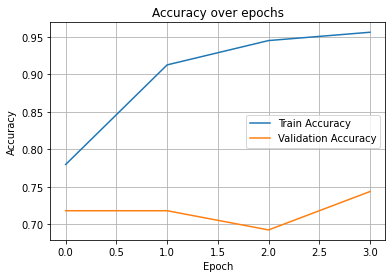

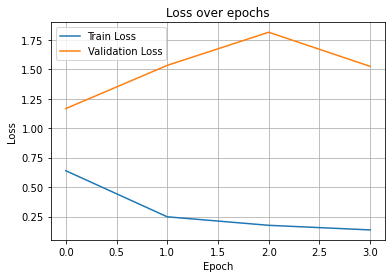

In [32]:
# 정확도 시각화
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy over epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

# 손실 시각화
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss over epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

## 예측 결과 시각화

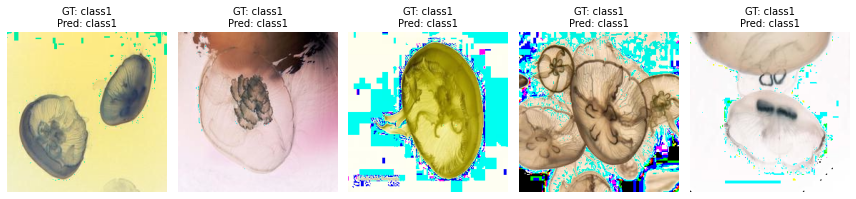

IndexError: list index out of range

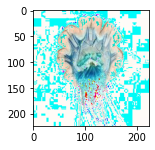

In [33]:
# 예측 결과 시각화
shown_classes = set()
for images, labels in test_ds.take(10):
    preds = model.predict(images)
    pred_labels = np.argmax(preds, axis=1)
    true_labels = np.argmax(labels.numpy(), axis=1)

    new_classes = set(true_labels) - shown_classes
    if not new_classes:
        continue

    shown_classes.update(new_classes)

    plt.figure(figsize=(12, 6))
    for i in range(min(5, len(images))):
        plt.subplot(1, 5, i+1)
        img = images[i].numpy() * 255  # 정규화 해제
        plt.imshow(img.astype("uint8"))
        plt.title(f"GT: {class_names[true_labels[i]]}\nPred: {class_names[pred_labels[i]]}", fontsize=10)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    if len(shown_classes) == len(class_names):
        break